In [ ]:
# if using mac, please run `brew install svn` to use svn

! svn export https://github.com/LabForComputationalVision/bias_free_denoising/trunk/data/Train400

In [1]:
path_to_image_data = 'Train400'

In [2]:
path_to_saved_models = './image_wavelet/saved_models/'

In [3]:
import os



import numpy as np
from torch.utils.data import DataLoader
import torch
import matplotlib.pyplot as plt

import cv2
from skimage.measure.simple_metrics import compare_psnr
import glob
import pickle

import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim

In [4]:
device = torch.device('cpu')

In [5]:
kernel_size = 2
noise_std_array = [float(10)/255, float(25)/255, float(55)/255];

n_examples = 3 #number of examples to plot

In [6]:
import sys
sys.path.append('image_wavelet')
sys.path.append('image_wavelet/multiscale_py/')

import image_dataset
import haar_soft_threshold_2d_net

In [7]:
net = haar_soft_threshold_2d_net.haar_soft_threshold_2d(kernel_size=2, 
                                                        max_orient = 2, 
                                                        max_level = 4, 
                                                        custom_wavelet = 'haar',
                                                        learn_transform_filters=False);


### Plot Function for Filter

In [8]:
def plot_matrix_color_and_numbers(ax = None, matrix = None, display_num = False, figsize = (20, 5), title_string = None, ax_off = False):

    if ax is None:
        fig, ax = plt.subplots(1, 1, sharex=False, sharey=False, figsize=figsize);
    
    _ = ax.matshow( matrix, cmap=plt.cm.Blues)

    if(display_num):
        for i in range(matrix.shape[1]):
            for j in range(matrix.shape[0]):
                c = matrix[j,i]
                ax.text(i, j, "{:.2f}".format(c), va='center', ha='center')

    ax.set_xlabel('Min: '+ "{:.2f}".format(np.min(matrix)) + ' Max: '+ "{:.2f}".format(np.max(matrix)) +' Mean: ' + "{:.2f}".format(np.mean(matrix)))
    
    if title_string is not None:
        ax.set_title(title_string)
        
    if ax_off:
        ax.axis('off')

def visualize_filters(net):
    fig, axes = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(20, 5));
    plt.setp(axes.flat,  adjustable='box-forced');
    
    axes[0].set_title('Filter');
    axes[1].set_title('FFT');
   
    filter_np = net.first_layer.weight.cpu().data.numpy()[0,0]
    plot_matrix_color_and_numbers(axes[0], 
                                  filter_np, net.kernel_size < 6)
    
    fft_matrix = abs( np.fft.fftshift( np.fft.fft2( filter_np, s=(180,180))) );
    plot_matrix_color_and_numbers(axes[1], fft_matrix, False)


### Creating Dataloader

n_val random images are set for validation while rest of the images are in training

In [9]:
n_val = 25;
files_source = glob.glob(os.path.join(path_to_image_data, '*.png'))
files_source = np.sort(files_source)
list_val_images = files_source[-n_val:]
list_train_images = list( set(files_source) - set(list_val_images));

In [10]:
train_dataset = image_dataset.Dataset(list_train_images, 
                                         resize_to_256 = True)
val_dataset = image_dataset.Dataset(list_val_images,
                                       resize_to_256 = True)

train_loader = DataLoader(dataset=train_dataset, 
                          num_workers=0, 
                          batch_size=128, shuffle=True);

val_loader = DataLoader(dataset = val_dataset,
                       num_workers = 0, 
                       batch_size = 32, 
                       shuffle = True)

# Image Statstics

In [11]:
def find_expected_coeff_square(train_dataset):
    n = len(train_dataset)
    abs_coeff_mat = 0;
    
    for i in range(n):
        temp = np.fft.fftshift( np.fft.fft2(train_dataset[i].data[0].numpy() ) )
        abs_coeff_mat += (np.absolute(temp) ** 2)
    
    abs_coeff_mat /= n
    
    return abs_coeff_mat

In [12]:
mean_coeff_sq = find_expected_coeff_square(train_dataset)

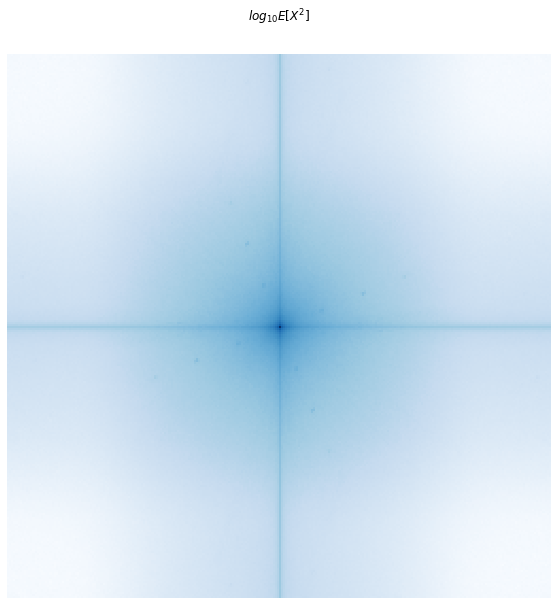

In [13]:
plot_matrix_color_and_numbers(ax = None, matrix = np.log10(mean_coeff_sq), display_num=False, title_string='$log_{10}E[X^2]$', figsize=(10, 10), ax_off = True)

In [14]:
def convert_2d_plot_to_1d(abs_coeff_mat):
    
    zero_x = abs_coeff_mat.shape[0]//2;
    zero_y = abs_coeff_mat.shape[1]//2;
    
    f_array = np.zeros(abs_coeff_mat.shape[0] * abs_coeff_mat.shape[1]);
    coeff_array = np.zeros(abs_coeff_mat.shape[0] * abs_coeff_mat.shape[1]);
    for i in range(abs_coeff_mat.shape[0]):
        for j in range(abs_coeff_mat.shape[1]):
            f_array[i*abs_coeff_mat.shape[1] + j] = np.sqrt((i-zero_x)**2 + (j-zero_y)**2);
            coeff_array[i*abs_coeff_mat.shape[1] + j] = abs_coeff_mat[i, j]

    sort_idx = np.argsort(f_array)
    coeff_array =  coeff_array[sort_idx]
    f_array = f_array[sort_idx]
    
    unique_f = np.unique(f_array)
    m = len(unique_f);

    unique_coeff = np.zeros(m);

    for i, x in enumerate(unique_f):
        same_idx = np.where(unique_f == x)[0];
        unique_coeff[i] = np.mean(coeff_array[same_idx]);
    
    return unique_f, unique_coeff

In [15]:
f_1d, mean_sq_coeff_1d = convert_2d_plot_to_1d(mean_coeff_sq);

Text(0.5, 1.0, '$log_{10}E[X^2]$ in 1D')

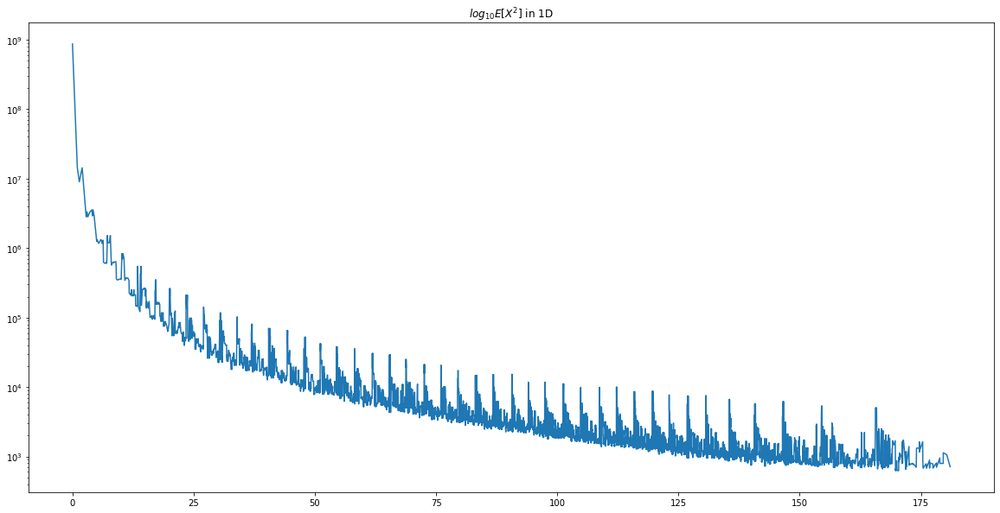

In [16]:
plt.figure(figsize = (20, 10))
plt.semilogy(f_1d, mean_sq_coeff_1d)
plt.title('$log_{10}E[X^2]$ in 1D')

## Look at Examples

In [17]:
def batch_PSNR(img, imclean, data_range):
    Img = img.data.cpu().numpy().astype(np.float32)
    Iclean = imclean.data.cpu().numpy().astype(np.float32)
    PSNR = 0
    for i in range(Img.shape[0]):
        PSNR += compare_psnr(Iclean[i,:,:,:], Img[i,:,:,:], data_range=data_range)
    return (PSNR/Img.shape[0])

In [18]:
def normalize(data):
    return data/255.

def get_test_image(path_to_dataset, index):
    files_source = glob.glob(os.path.join(path_to_dataset, '*.png'))
    files_source.sort()
    
    f = files_source[index];
    
    Img = cv2.imread(f)
    Img = normalize(np.float32(Img[:,:,0]))
    Img = np.expand_dims(Img, 0)
    Img = np.expand_dims(Img, 1)
    ISource = torch.Tensor(Img).to(device)
    
    return ISource
    

In [19]:
def get_noise(data, noise_std = 0.1, mode='S', max_noise = 5e-1):
    noise = torch.randn_like(data);
    if mode == 'B':
        n = noise.shape[0];
        noise_tensor_array = max_noise * torch.rand(n);
        for i in range(n):
            noise.data[i] = noise.data[i] * noise_tensor_array[i];
    else:
        noise.data = noise.data * noise_std;
    return noise

In [20]:
def tensor_to_image(torch_image, low=0.0, high = 1.0, clamp = True):
    if clamp:
        torch_image = torch.clamp(torch_image, low, high);
    return torch_image[0,0].cpu().data.numpy()

In [21]:
def plot_2d_log_fft(image, ax = None, ax_off = True, title_string = None):
    fft = np.fft.fftshift( np.fft.fft2(image) );
    mat = np.log10( np.abs(fft) )
    
    if title_string is None:
        plot_matrix_color_and_numbers(ax = ax, matrix=mat, display_num=False, ax_off = ax_off)
    else:
        plot_matrix_color_and_numbers(ax = ax, matrix=mat, display_num=False, title_string = title_string, ax_off = ax_off)
    

In [22]:
def visualize_denoising(source, net, noise_std, noise_sample = None, figsize = (20, 20)):
    fig, axes = plt.subplots(2, 3, sharex=True, sharey='row', figsize=figsize);
    
    axes[0, 0].imshow(tensor_to_image(source), cmap='gray')
    axes[0, 0].axis('off')
    plot_2d_log_fft(tensor_to_image(source), axes[1, 0]);
    
    if noise_sample is None:
        noise_sample = get_noise(source, noise_std);
    
    noisy = source + noise_sample;
    
    axes[0, 1].imshow(tensor_to_image(noisy), cmap='gray')
    axes[0, 1].axis('off')
    axes[0, 1].set_title(str(batch_PSNR(noisy, source, 1.)))
    plot_2d_log_fft(tensor_to_image(noisy), axes[1, 1]);
    
    denoised = net(noisy);
    
    
    axes[0, 2].imshow(tensor_to_image(denoised), cmap='gray')
    axes[0, 2].axis('off')
    axes[0, 2].set_title(str(batch_PSNR(torch.clamp(denoised, 0.0, 1.0), source, 1.)))
    plot_2d_log_fft(tensor_to_image(denoised), axes[1, 2]);
    
#     plt.tight_layout()
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

### Visalizing Before Training

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until


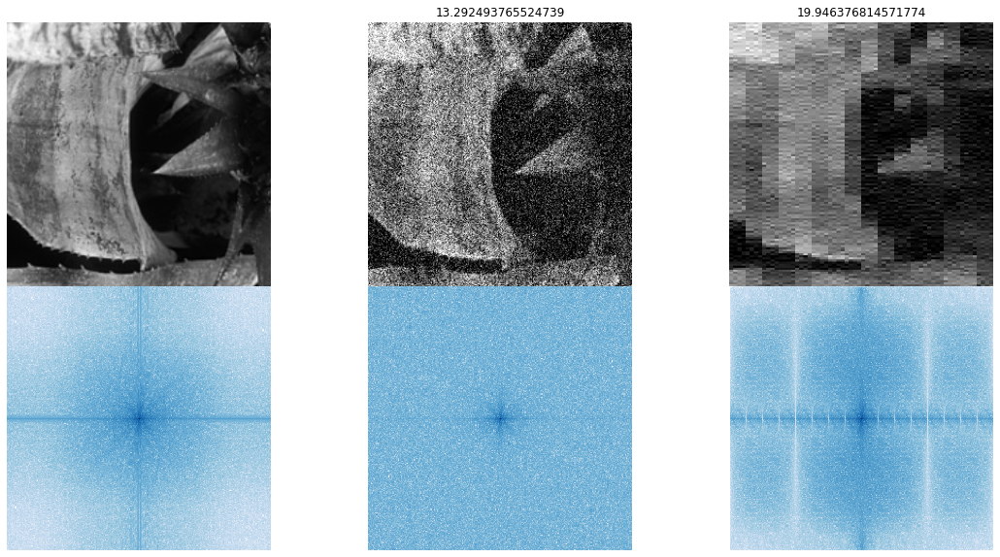

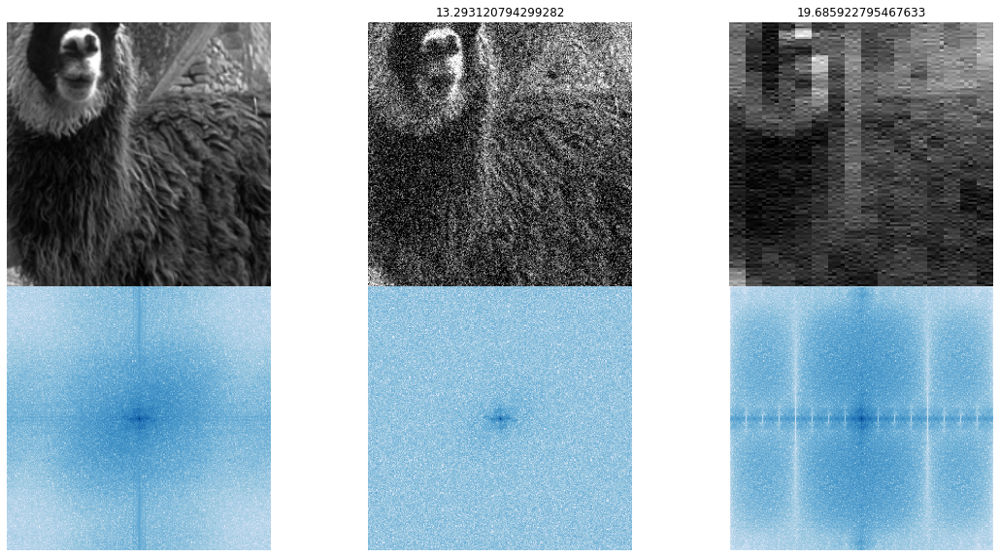

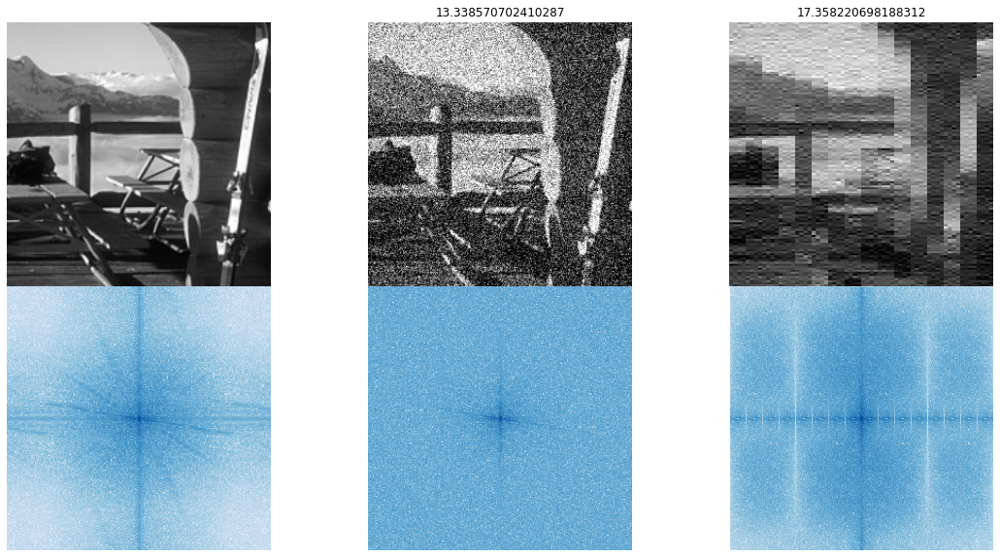

In [23]:
noise_std = np.random.choice(noise_std_array)
for i in range(n_examples):
    visualize_denoising(val_dataset[i].unsqueeze(0).to(device), net, noise_std, figsize=(20, 10))

## Theoretical Wiener Filter

In [24]:
def theoretical_wiener_from_data(train_dataset, noise_std, fft_shift = True, fft_sample = (180, 180),  n = 10):
    mean_coeff = np.fft.fft2(train_dataset[0].numpy()[0], s = fft_sample) * 0;

    for i in range(n):
        for x in train_dataset:
            noisy = x + get_noise(x, noise_std=noise_std);
            noise_fft = ( np.fft.fft2(noisy.numpy()[0], s = fft_sample) );
            clean_fft = ( np.fft.fft2(x.numpy()[0], s = fft_sample) );

            mean_coeff += clean_fft * np.conjugate(noise_fft) / np.abs(noise_fft)**2

    mean_coeff /= n*len(train_dataset)
    if fft_shift:
        return np.fft.fftshift(mean_coeff)
    else:
        return mean_coeff

In [25]:
def theoretical_wiener_from_expected_coeff_sq(mean_coeff_sq, noise_std, n):
    return mean_coeff_sq/( mean_coeff_sq +  (n*noise_std)**2 )

In [26]:
def plot_filter_and_fft_from_fft(fft_mat, s= 17):
    fig, axes = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(20, 5));
    
    axes[0].set_title('Filter');
    axes[1].set_title('$log_{10}(FFT)$');
    
    filter_np = np.real( np.fft.ifft2( np.fft.ifftshift(fft_mat), s = (s, s) ) );
   
    plot_matrix_color_and_numbers(axes[0], 
                                  filter_np, display_num = (s < 7) );
    
    
    plot_matrix_color_and_numbers(axes[1], (np.abs(fft_mat)), False);


### Visualizing filters

noise level:  0.0392156862745098


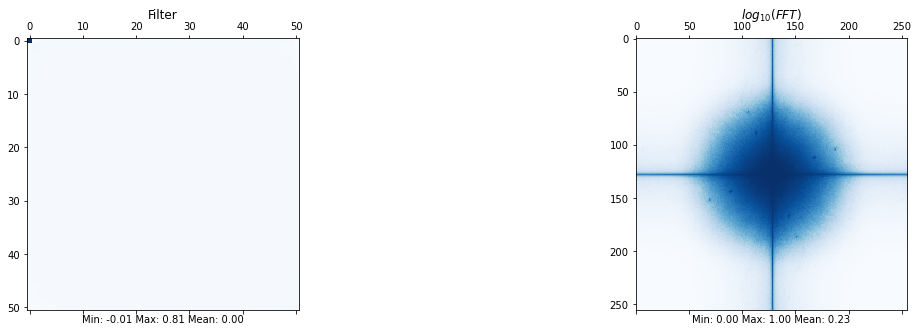

noise level:  0.09803921568627451


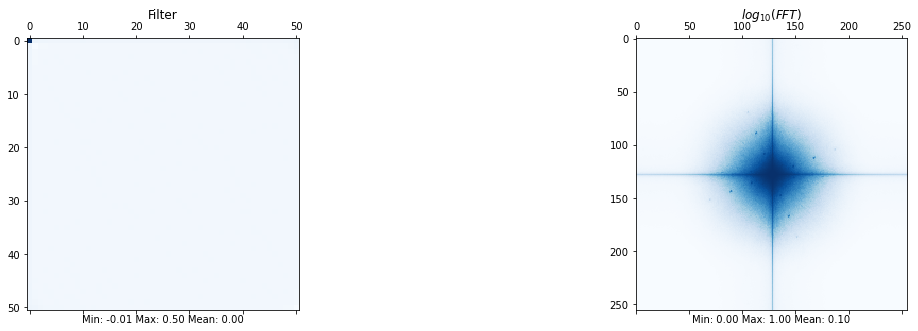

noise level:  0.21568627450980393


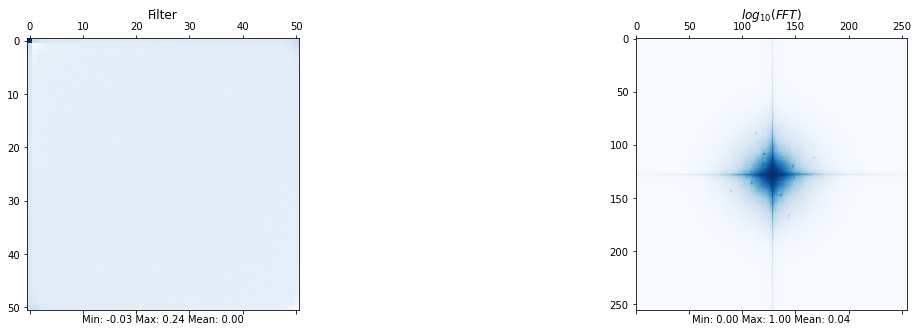

In [27]:
wiener_star = {}
for noise_std in noise_std_array:
    print('noise level: ', noise_std)
#     wiener_star[noise_std] = theoretical_wiener_from_data(train_dataset, noise_std)
    wiener_star[noise_std] = theoretical_wiener_from_expected_coeff_sq(mean_coeff_sq, noise_std, len(train_dataset));
    plot_filter_and_fft_from_fft(wiener_star[noise_std], s = 51)
    plt.show()

### Visualize Theoretical Wiener Denoising

In [28]:
def best_wiener_loss_and_psnr(val_dataset, noise_std, wiener_star, fft_sample= (180, 180)):
    mean_loss = 0;
    mean_psnr = 0;
    for source in val_dataset:
        noisy = source + get_noise(source, noise_std=noise_std)
        source = source.numpy()[0]
        noisy = noisy.numpy()[0]

        source_fft = np.fft.fftshift( np.fft.fft2(source, s = fft_sample) );
        noisy_fft = np.fft.fftshift( np.fft.fft2(noisy, s = fft_sample) );
        denoised_fft = noisy_fft * wiener_star;

        source_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(source_fft), s= fft_sample) ), 0., 1. );
        noisy_ifft = np.clip( np.real(np.fft.ifft2( np.fft.ifftshift( noisy_fft), s = fft_sample)), 0., 1. );
        denoised_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(denoised_fft), s = fft_sample)), 0., 1. );
        
        mean_loss += np.linalg.norm(denoised_ifft - source_ifft)**2;
        mean_psnr += compare_psnr(source_ifft, denoised_ifft, data_range=1.)
        
    return mean_loss/len(val_dataset), mean_psnr/len(val_dataset)

In [29]:
def visualize_best_wiener_denoising(source, noise_std, wiener_star, figsize = (20, 10), fft_sample = (180, 180)):
    
    
    noisy = source + get_noise(source, noise_std=noise_std)
    source = source.numpy()[0]
    noisy = noisy.numpy()[0]
    
    source_fft = np.fft.fftshift( np.fft.fft2(source, s = fft_sample) );
    noisy_fft = np.fft.fftshift( np.fft.fft2(noisy, s = fft_sample) );
    denoised_fft = noisy_fft * wiener_star;
    
    source_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(source_fft), s= fft_sample) ), 0., 1. );
    noisy_ifft = np.clip( np.real(np.fft.ifft2( np.fft.ifftshift( noisy_fft), s = fft_sample)), 0., 1. );
    denoised_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(denoised_fft), s = fft_sample)), 0., 1. );
    
    fig, axes = plt.subplots(2, 3, sharex=True, sharey='row', figsize=figsize);
    axes[0, 0].imshow( source_ifft, cmap = 'gray' )
    axes[0, 0].axis('off')
    plot_2d_log_fft(source_ifft, axes[1, 0]);
    
    axes[0,1].imshow( noisy_ifft, cmap='gray' )
    axes[0,1].set_title(str( compare_psnr(source_ifft, noisy_ifft, data_range=1.)) )
    axes[0,1].axis('off')
    plot_2d_log_fft(noisy_ifft, axes[1, 1]);
    
    
    axes[0,2].imshow(denoised_ifft, cmap = 'gray')
    axes[0,2].set_title(str( compare_psnr(source_ifft, denoised_ifft, data_range=1.)) )
    axes[0,2].axis('off')
    plot_2d_log_fft(denoised_ifft, axes[1, 2]);
    
    plt.subplots_adjust(wspace=0, hspace=0)
    
    plt.show()



Noise Std:  0.0392156862745098


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:22: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.


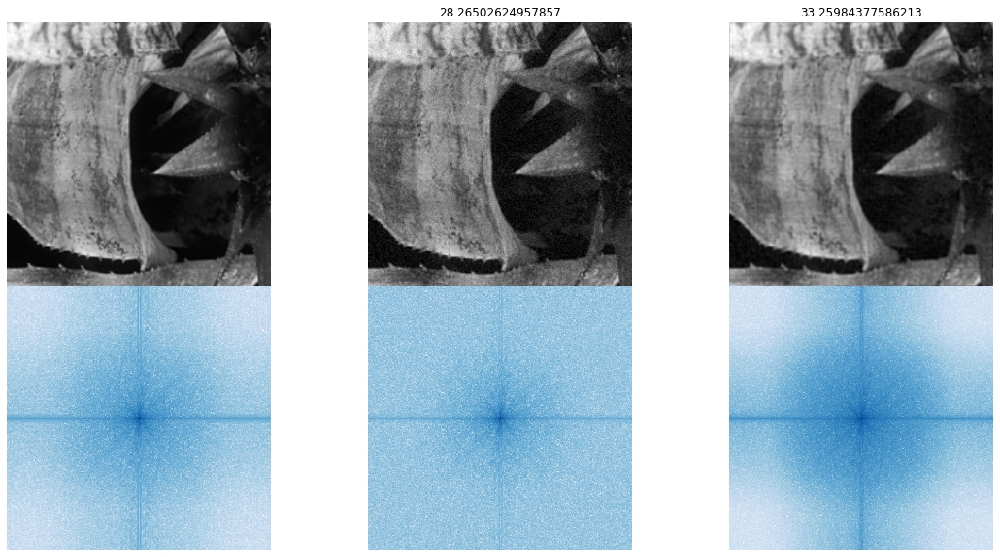

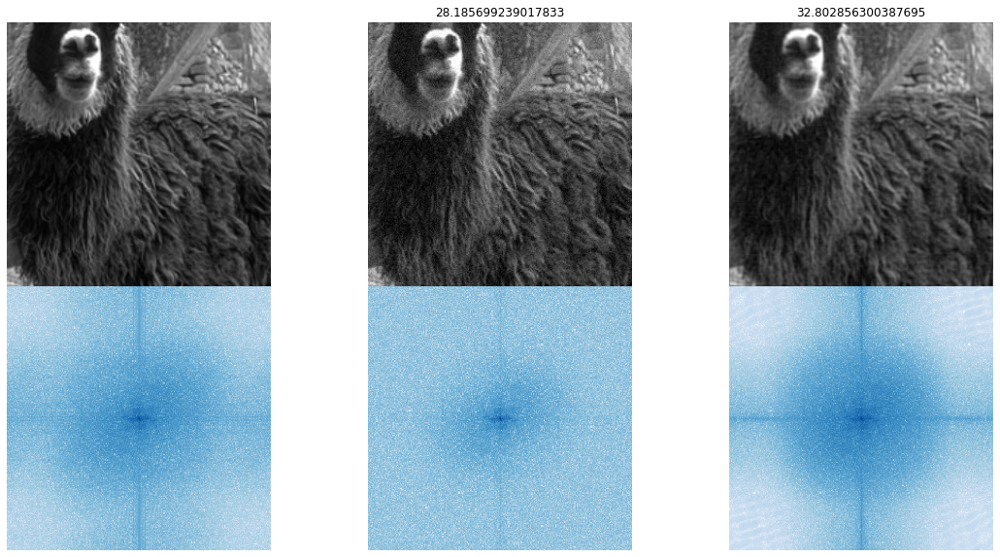

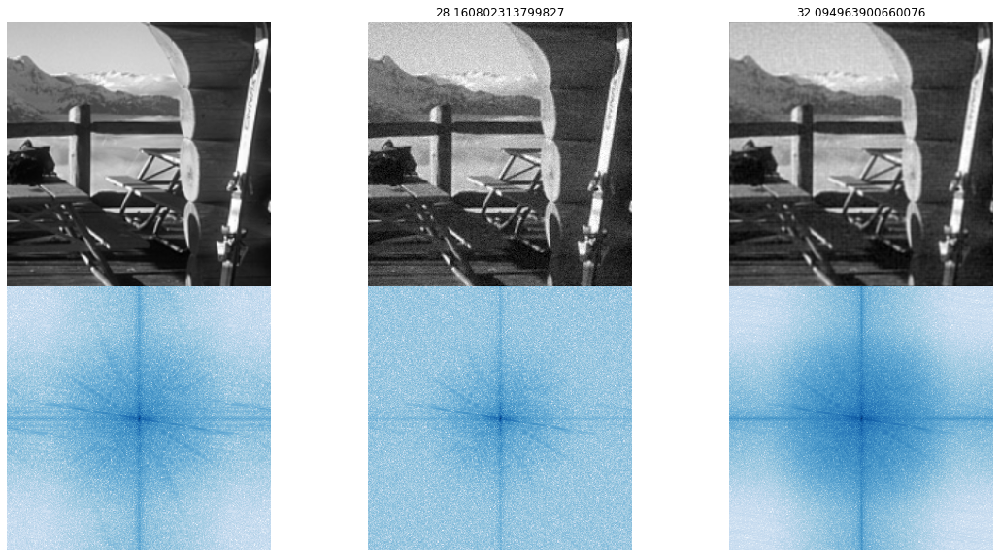



Noise Std:  0.09803921568627451


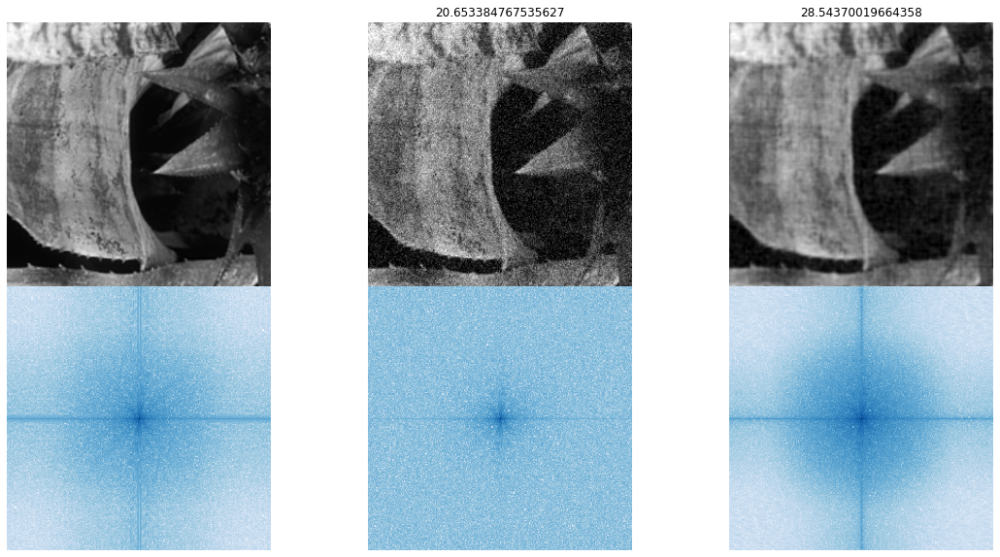

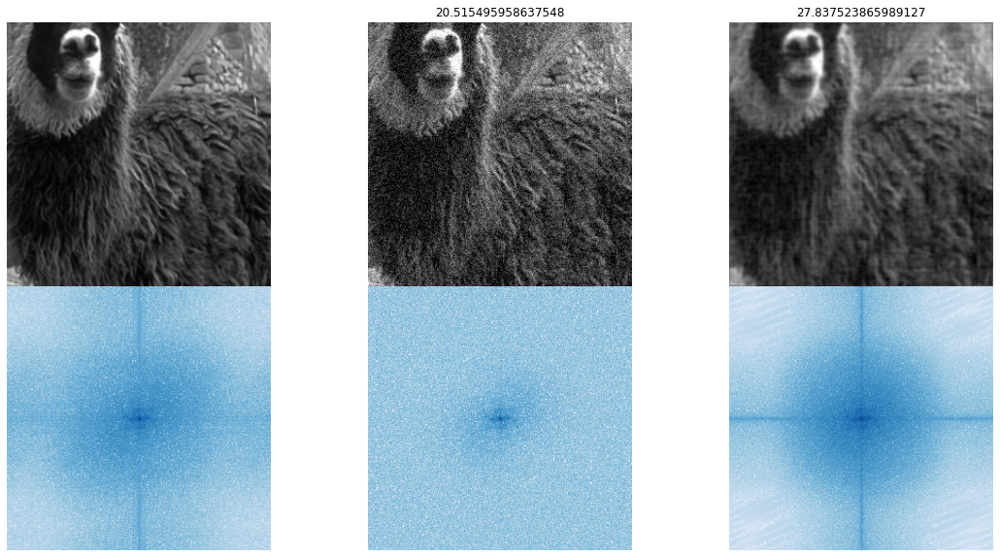

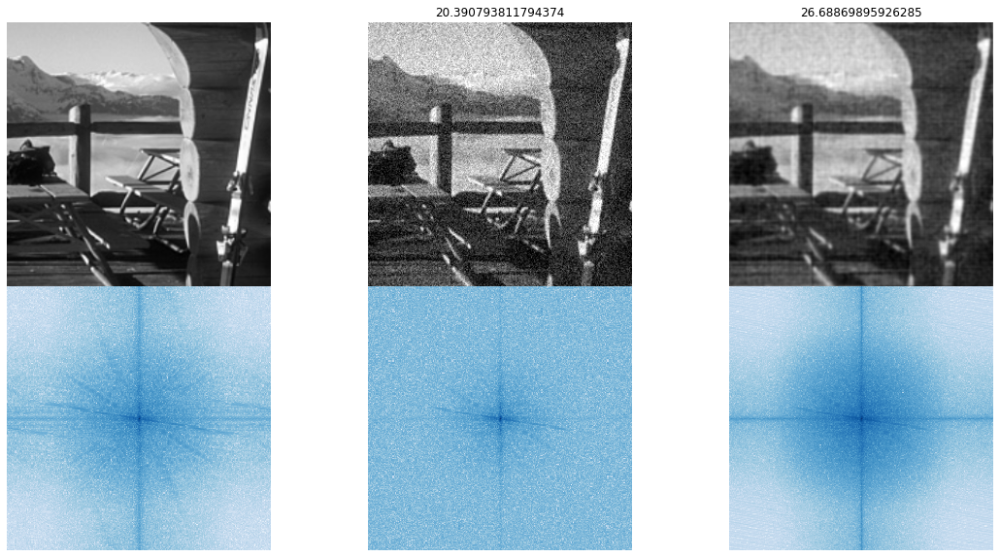



Noise Std:  0.21568627450980393


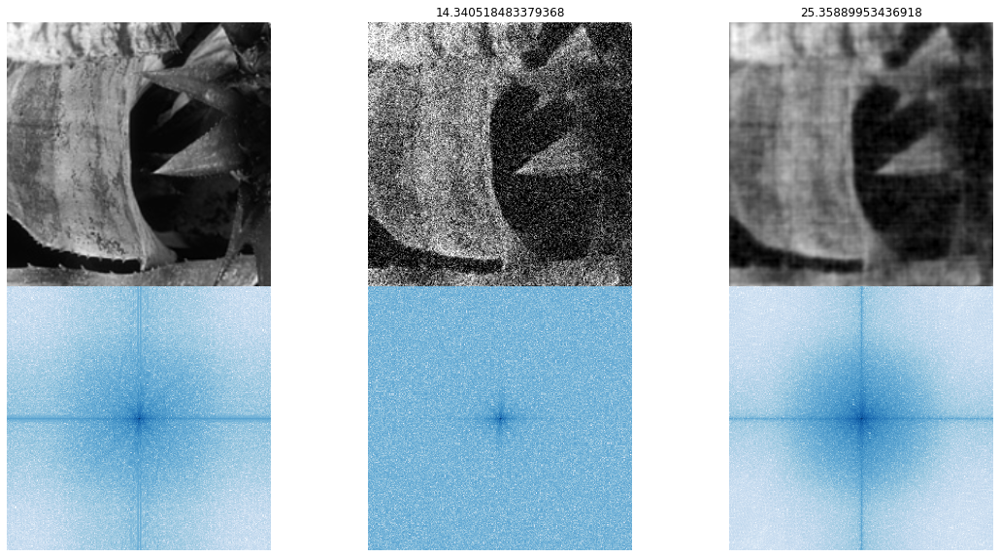

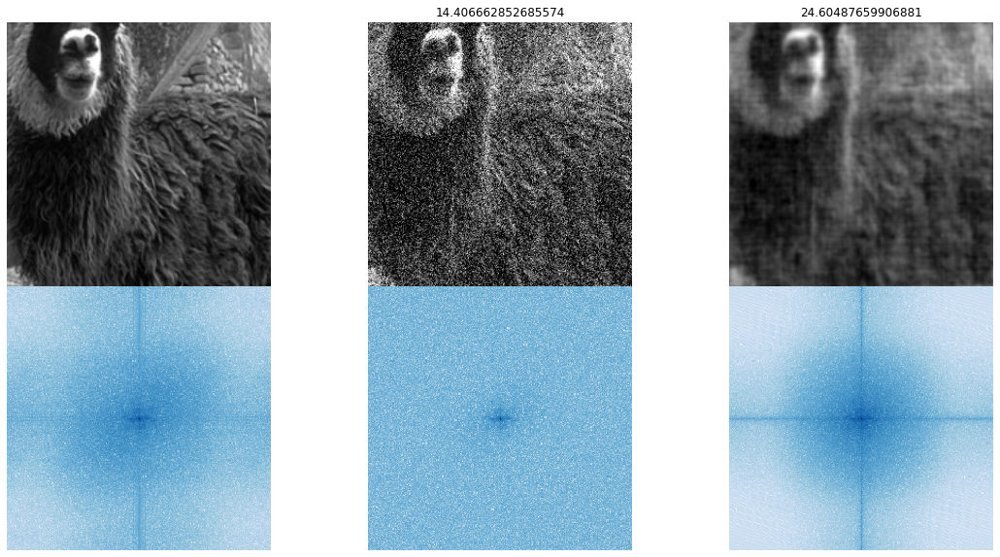

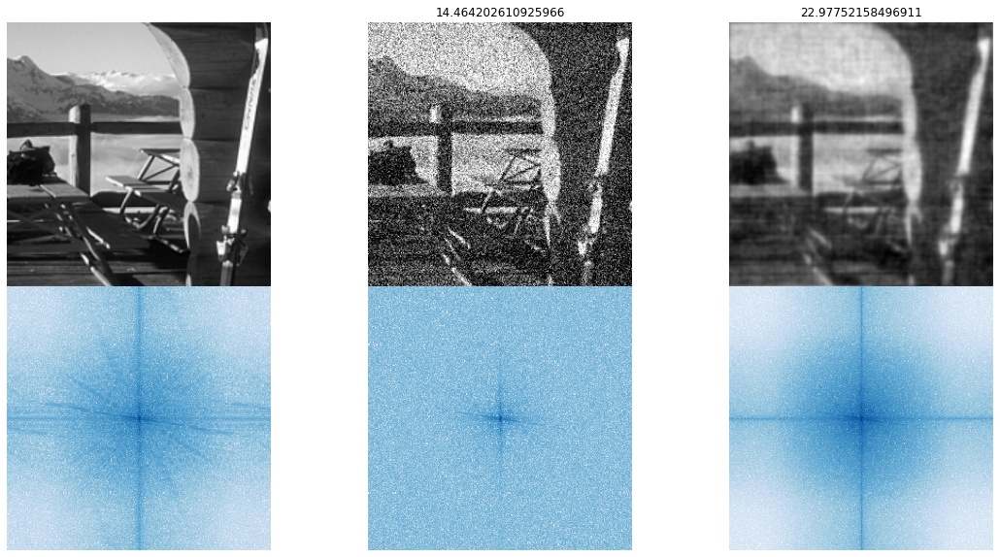

In [30]:
for noise_std in noise_std_array:
    print('='*50 +'\n\n')
    print('Noise Std: ', noise_std) 
    for i in range(n_examples):
        visualize_best_wiener_denoising(val_dataset[i], noise_std, wiener_star[noise_std], fft_sample=(val_dataset[i][0].shape[0], val_dataset[i][0].shape[1]))

### Performance of Theoretical Wiener

In [31]:
for noise_std in noise_std_array:
    print('noise std: ', noise_std)
    wiener_star_loss, wiener_star_psnr = best_wiener_loss_and_psnr(val_dataset, noise_std, wiener_star[noise_std], fft_sample = (256, 256))
    print('Loss: ', wiener_star_loss)
    print('PSNR: ', wiener_star_psnr)
    print('='*50 + '\n')

noise std:  0.0392156862745098
Loss:  39.16467402748994
PSNR:  32.7493165413361

noise std:  0.09803921568627451


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:18: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.


Loss:  120.4398080120066
PSNR:  27.971227581298326

noise std:  0.21568627450980393
Loss:  258.3931132264635
PSNR:  24.70222078445142



# Soft Thresholding With Haar Wavelets

All the thresholding functions were formulated as a soft differentiable approximation with the threshold as the function parmeter. This was put into a wavelet framework and optimized over a dataset to minimize the mean squared error. Please look into the the folder `multiscale_py` for details on implementation

### Training

In [32]:
def validation_error_psnr(model, dataset_val, add_noise = False, noise_std = 0.1, noise_mode = 'S', max_noise = 5e-1):
    model.eval()
    error_val = 0;
    psnr_val = 0;
    total_length = 0;

    criterion = nn.MSELoss(reduction = 'sum');

    for data in dataset_val:
        target = data.clone();

        if add_noise:
            data = data + get_noise(data, noise_std, mode = noise_mode, max_noise = max_noise);

        out_val = model( data );

        error_val += criterion(out_val, target).item()
        psnr_val += ( batch_PSNR(out_val, target, 1.0) * data.shape[0] )
        total_length += data.shape[0];

    return error_val/total_length, psnr_val/total_length

In [33]:
def train_network_on_noise(model, train_loader, val_loader, 
                            add_noise = False, noise_std = 0.1, noise_mode = 'S', max_noise = 5e-1,
                            max_epoch = 50,  milestone = 50, lr=0.001, plot_loss = True, verbose = False,
                            verbose_freq = 100, early_stopping = True):

    optimizer = optim.Adam( filter(lambda p: p.requires_grad, model.parameters()) , lr=lr);
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'max', patience = 5, factor = 0.5)
    criterion = nn.MSELoss()

    train_loss = np.zeros(max_epoch);
    val_loss = np.zeros(max_epoch);
    
    train_psnr = np.zeros(max_epoch);
    val_psnr = np.zeros(max_epoch);
    
    best_model = None;
    best_val_loss = np.inf;

    for epoch in range(max_epoch):

#         if epoch > milestone:
#             for param_group in optimizer.param_groups:
#                 param_group["lr"] = lr/10;

        for i, data in enumerate(train_loader):
            optimizer.zero_grad();
            model.train();

            target = data.clone();

            if add_noise:
                noise = get_noise(data, noise_std, mode = noise_mode, max_noise = max_noise);
                data = data + noise

            out_train = model(data);
            loss = criterion(out_train, target);           
            loss.backward()
            optimizer.step()

        train_loss[epoch], train_psnr[epoch] = validation_error_psnr(model, train_loader, 
                                                                add_noise = add_noise, noise_std = noise_std);
        val_loss[epoch], val_psnr[epoch] = validation_error_psnr(model, val_loader, 
                                                            add_noise = add_noise, noise_std =  noise_std);
        scheduler.step(val_psnr[epoch])
        
        if (epoch+1) % verbose_freq == 0 and verbose:
            print(epoch+1, 'train error: ', train_loss[epoch],
                             'val error: ', val_loss[epoch], 
                              'train psnr: ', train_psnr[epoch],
                             'val psnr: ', val_psnr[epoch]);

        if val_loss[epoch] < best_val_loss:
            best_model = model.state_dict();
            best_val_loss = val_loss[epoch]

    if early_stopping:
        model.load_state_dict(best_model)
        
    if plot_loss:
        plt.semilogy(np.arange(1, max_epoch+1), train_loss, label = 'train loss');
        plt.semilogy(np.arange(1, max_epoch+1), val_loss, label = 'val loss')
        plt.legend()
        plt.show()
        
        plt.plot(np.arange(1, max_epoch+1), train_psnr, label = 'train psnr');
        plt.plot(np.arange(1, max_epoch+1), val_psnr, label = 'val psnr')
        plt.legend()
        plt.show()

    return model

In [34]:
kernel_size_list = [2];
super_net_dict = {};

In [35]:
for noise_std in noise_std_array:
    print('='*50)
    print('noise std: ', noise_std);
    
    string_noise_std = str(int(noise_std*1000));
    
    net_dict_filename = 'haar_image_'+string_noise_std+'.pth';
    
    if os.path.exists(os.path.join(path_to_saved_models, net_dict_filename)): 
        print('Loaded from file..')
        net_dict = pickle.load( open( os.path.join(path_to_saved_models, net_dict_filename), "rb" ) )
#         kernel_size_list = list(net_dict.keys());
        super_net_dict[noise_std] = net_dict;
    else:
        net_dict = {}
        print('Training..')
        for kernel_size in kernel_size_list:
            net_temp = haar_soft_threshold_2d_net.haar_soft_threshold_2d(kernel_size=kernel_size, 
                                                        max_orient = 4, 
                                                        max_level = 4, 
                                                        custom_wavelet = 'haar',
                                                        learn_transform_filters=False);

            net_temp = train_network_on_noise(net_temp, train_loader, val_loader, 
                                    add_noise = True, 
                                    noise_std = noise_std, 
                                    noise_mode = 'S', 
                                    max_epoch = 100, 
                                    milestone = 50, 
                                    lr = 1e-1, 
                                    verbose = True, 
                                    verbose_freq = 5, 
                                    plot_loss = True)
#             visualize_filters(net_temp)
            plt.show()
            print('='*50)
            net_dict[kernel_size] = net_temp;
            pickle.dump(net_dict, open( os.path.join(path_to_saved_models, net_dict_filename), "wb" ) )
        super_net_dict[noise_std] = net_dict;

noise std:  0.0392156862745098
Loaded from file..
noise std:  0.09803921568627451
Loaded from file..
noise std:  0.21568627450980393
Loaded from file..


### Val MSE and PNR for different kernel size

In [36]:
best_kernel_size = {};

for noise_std in noise_std_array:
    
    print('noise std: ', noise_std)
    best_kernel_psnr = 0;
    best_kernel = 0;
    for kernel_size in kernel_size_list:
        val_loss, val_psnr= validation_error_psnr(super_net_dict[noise_std][kernel_size], val_loader, 
                                                                add_noise = True, noise_std =  noise_std);
        print('Kernel Size: ', kernel_size, 'Val MSE: ', val_loss, 'Val PSNR: ', val_psnr)
#         visualize_filters(net_dict[kernel_size])
        plt.show()
        if val_psnr > best_kernel_psnr:
            best_kernel_psnr = val_psnr;
            best_kernel = kernel_size;
            
    best_kernel_size[noise_std] = best_kernel;
    print('='*50 + '\n\n')

noise std:  0.0392156862745098
Kernel Size:  2 Val MSE:  44.93431640625 Val PSNR:  31.84151908058251


noise std:  0.09803921568627451
Kernel Size:  2 Val MSE:  143.35765625 Val PSNR:  27.005712036590143


noise std:  0.21568627450980393
Kernel Size:  2 Val MSE:  291.1219140625 Val PSNR:  23.983865568343766




/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


In [37]:
def plot_activation_functions(net, figsize = (20, 5), max_val = 1):
    max_level = net.denoising_net.max_level;
    max_orient =  net.denoising_net.max_orient;
    
    x_array = torch.arange(-1 * max_val, 1*max_val, 0.005);
    x_array_np = x_array.data.numpy();
    
    for level in range(1, max_level+1):   
        fig, ax = plt.subplots(1, max_orient-1, sharex=True, sharey=False, figsize=figsize);
        
        for orient in range(max_orient-1):
            y = net.denoising_net.neural_net_dict[str(level)][orient+1](x_array)
            ax[orient].plot(x_array_np, y.data.numpy() )
            ax[orient].set_title('level: ' + str(level) +' orient: '+ str(orient) +' bias: ' + str(net.denoising_net.neural_net_dict[str(level)][orient].bias.data.numpy() ) )
        plt.show()    

## Look at the learned thresholding function at each sub-band

noise std:  0.0392156862745098


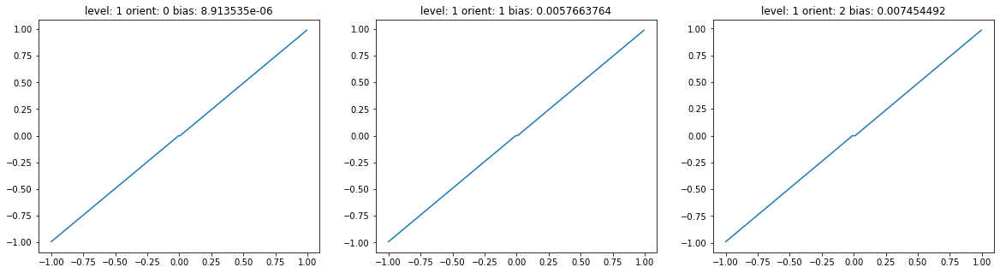

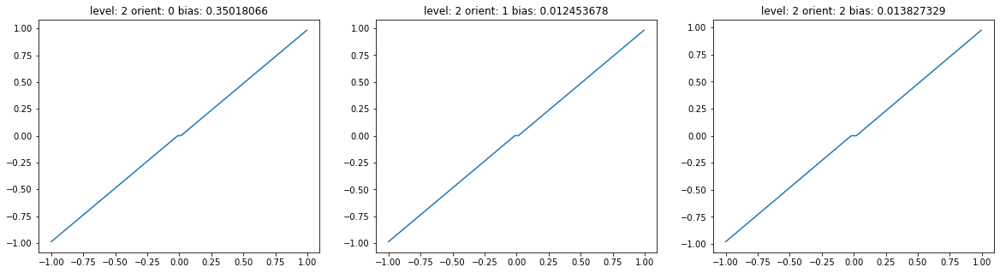

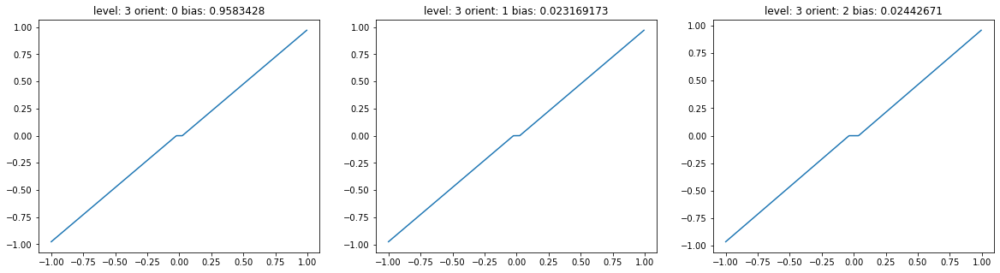

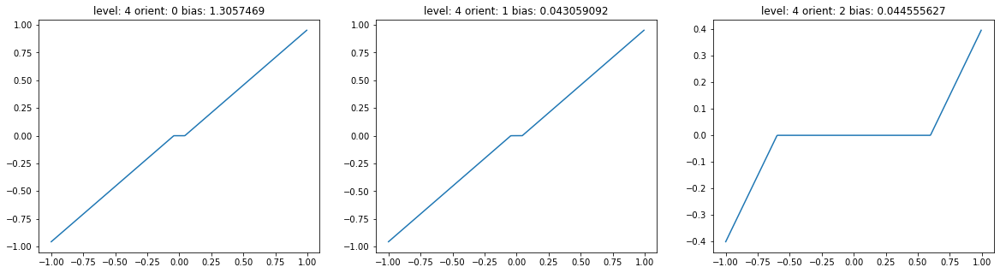

noise std:  0.09803921568627451


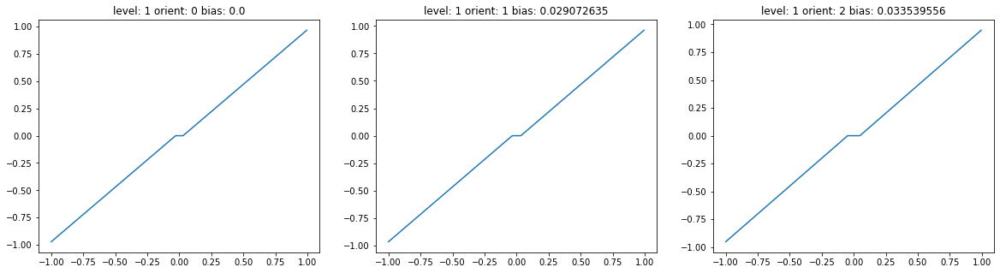

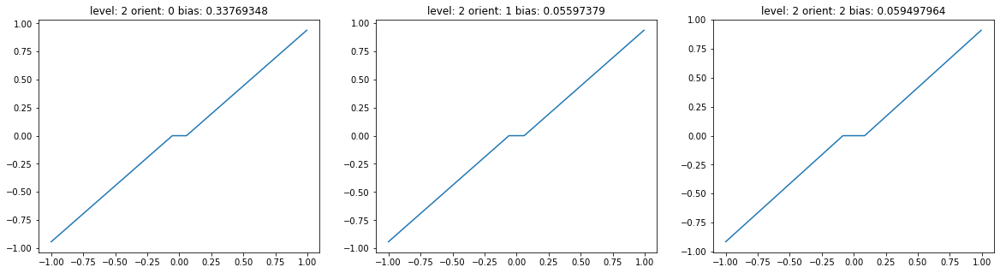

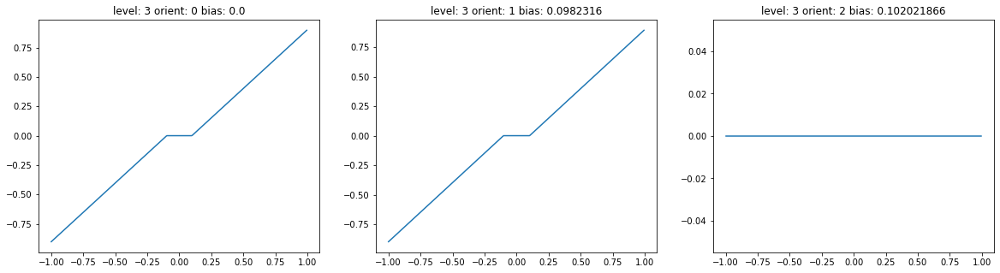

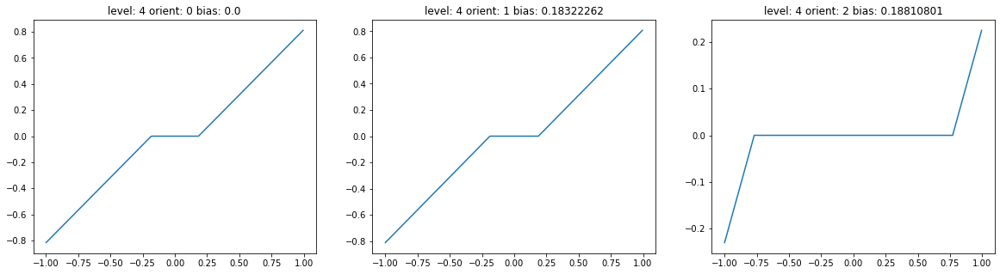

noise std:  0.21568627450980393


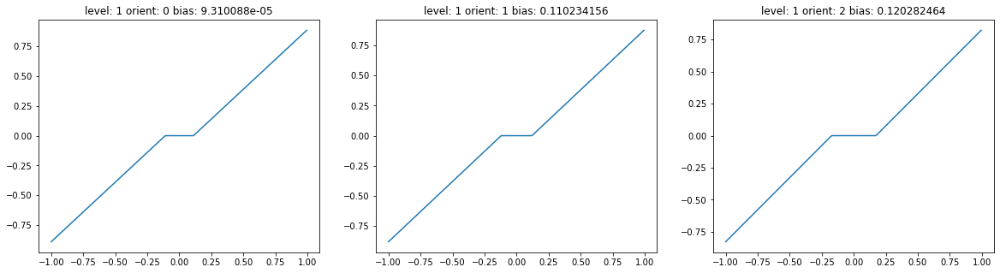

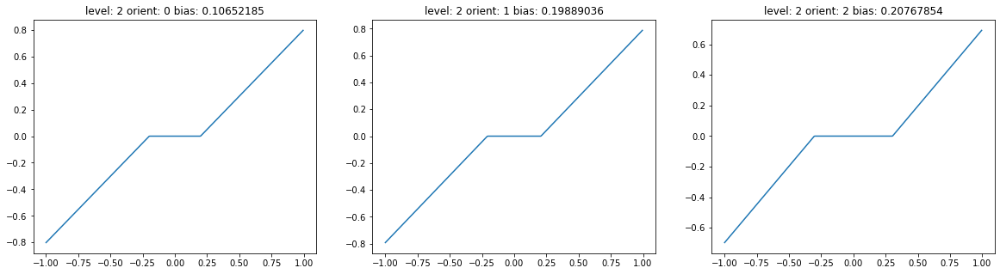

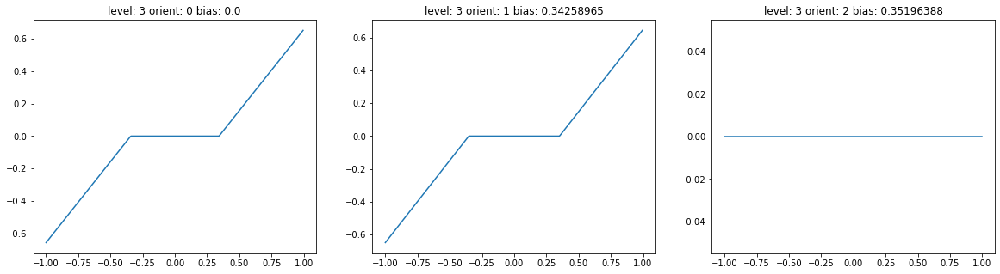

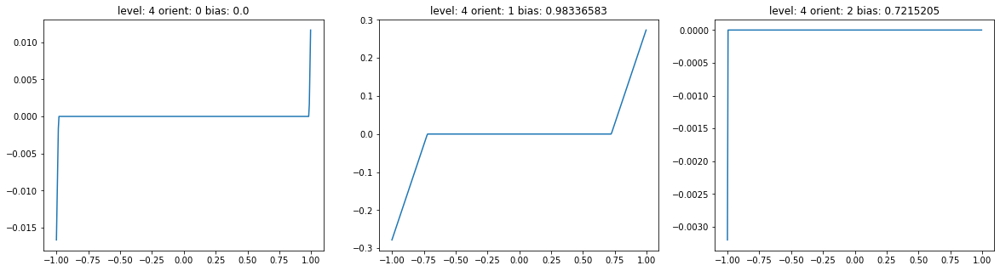

In [38]:
for noise_std in noise_std_array:
    print('noise std: ', noise_std)
    for kernel_size in kernel_size_list:
        plot_activation_functions(super_net_dict[noise_std][kernel_size])
    print('='*50)

## Compare Soft Thresholding with Wiener]

In [39]:
def compare_wiener_and_wavelet(source, noise_std, wiener_star, net, figsize = (20, 10), fft_sample = (180, 180)):
    
    
    noisy = source + get_noise(source, noise_std=noise_std)
    wavelet_denoised = net(noisy.unsqueeze(0));
    
    source_torch = source.clone().unsqueeze(0);
    source = source.numpy()[0]
    noisy = noisy.numpy()[0]
    
    
    source_fft = np.fft.fftshift( np.fft.fft2(source, s = fft_sample) );
    noisy_fft = np.fft.fftshift( np.fft.fft2(noisy, s = fft_sample) );
    denoised_fft = noisy_fft * wiener_star;
    
    source_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(source_fft), s= fft_sample) ), 0., 1. );
    noisy_ifft = np.clip( np.real(np.fft.ifft2( np.fft.ifftshift( noisy_fft), s = fft_sample)), 0., 1. );
    denoised_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(denoised_fft), s = fft_sample)), 0., 1. );
    
    fig, axes = plt.subplots(2, 4, sharex=True, sharey='row', figsize=figsize);
    axes[0, 0].imshow( source_ifft, cmap = 'gray' )
    axes[0, 0].axis('off')
    plot_2d_log_fft(source_ifft, axes[1, 0]);
    
    axes[0,1].imshow( noisy_ifft, cmap='gray' )
    axes[0,1].set_title(str( compare_psnr(source_ifft, noisy_ifft, data_range=1.)) )
    axes[0,1].axis('off')
    plot_2d_log_fft(noisy_ifft, axes[1, 1]);
    
    
    axes[0,2].imshow(denoised_ifft, cmap = 'gray')
    axes[0,2].set_title(str( compare_psnr(source_ifft, denoised_ifft, data_range=1.)) )
    axes[0,2].axis('off')
    plot_2d_log_fft(denoised_ifft, axes[1, 2]);
    
    axes[0, 3].imshow(tensor_to_image(wavelet_denoised), cmap='gray')
    axes[0, 3].axis('off')
    axes[0, 3].set_title(str(batch_PSNR(torch.clamp(wavelet_denoised, 0.0, 1.0), source_torch, 1.)))
    plot_2d_log_fft(tensor_to_image(wavelet_denoised), axes[1, 3]);
    
    plt.subplots_adjust(wspace=0, hspace=0)
    
    plt.show()

In [40]:
image_number_list = [227]

In [41]:
special_image_list = [os.path.join(path_to_image_data, 'test_'+str(x)+'.png') for x in image_number_list]

In [42]:
special_image_dataset = image_dataset.Dataset(special_image_list, resize_to_256=True)



Noise Std:  0.0392156862745098


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:26: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:32: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


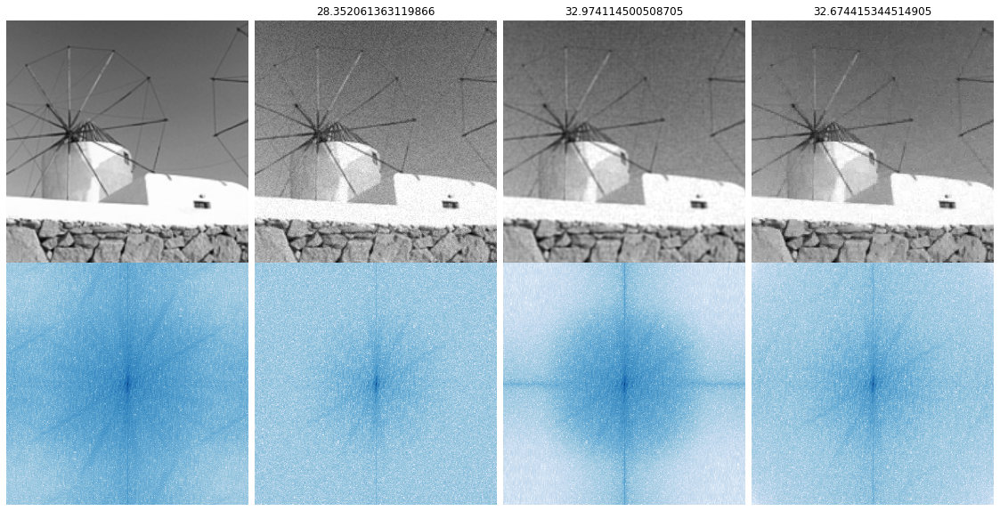



Noise Std:  0.09803921568627451


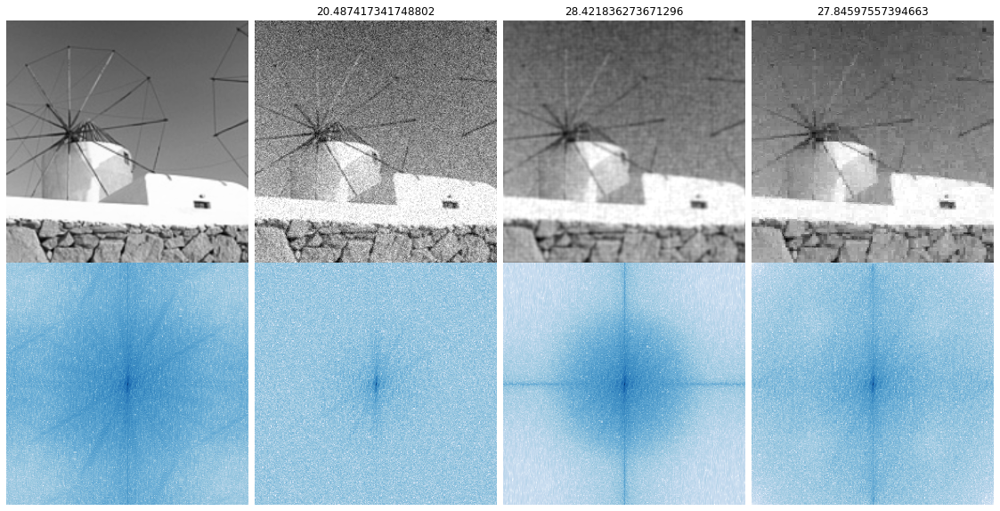



Noise Std:  0.21568627450980393


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until


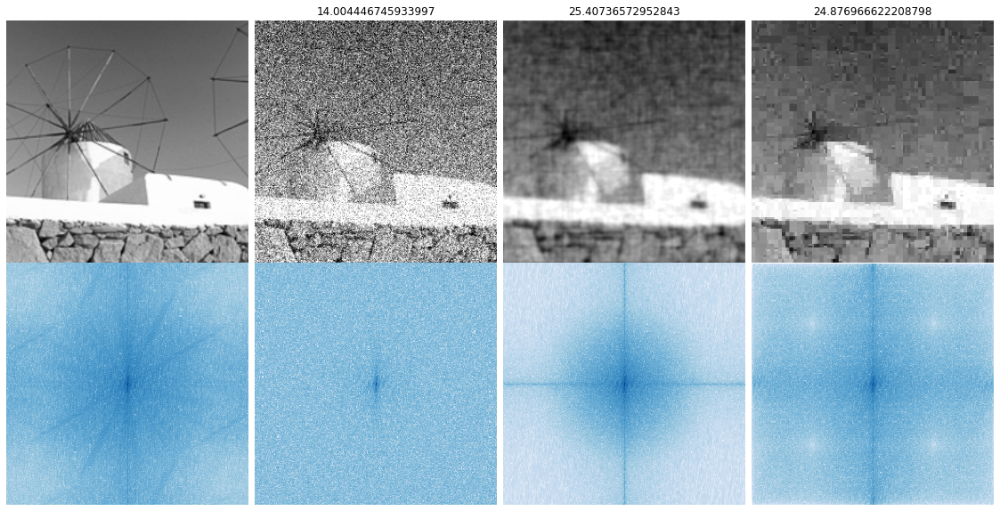

In [43]:
for noise_std in noise_std_array:
    print('='*50 +'\n\n')
    print('Noise Std: ', noise_std) 
    for i in range(len(special_image_dataset)):
        compare_wiener_and_wavelet(special_image_dataset[i], noise_std, wiener_star[noise_std],
                                       super_net_dict[noise_std][best_kernel_size[noise_std]], fft_sample = (256, 256))

# Hard Thresholding with Haar Wavelets

In [44]:
import haar_hard_threshold_2d_net

In [45]:
hard_net_dict = {};

In [46]:
for noise_std in noise_std_array:
    print('='*50)
    print('noise std: ', noise_std);
    
    string_noise_std = str(int(noise_std*1000));
    
    net_dict_filename = 'haar_hard_'+string_noise_std+'.pth';
    
    if os.path.exists(os.path.join(path_to_saved_models, net_dict_filename)): 
        print('Loaded from file..')
        net_dict = pickle.load( open( os.path.join(path_to_saved_models, net_dict_filename), "rb" ) )
#         kernel_size_list = list(net_dict.keys());
        hard_net_dict[noise_std] = net_dict;
    else:
        net_dict = {}
        print('Training..')
        for kernel_size in kernel_size_list:
            net_temp = haar_hard_threshold_2d_net.haar_hard_threshold_2d(kernel_size=kernel_size, 
                                                        max_orient = 4, 
                                                        max_level = 4, 
                                                        custom_wavelet = 'haar',
                                                        learn_transform_filters=False);

            net_temp = train_network_on_noise(net_temp, train_loader, val_loader, 
                                    add_noise = True, 
                                    noise_std = noise_std, 
                                    noise_mode = 'S', 
                                    max_epoch = 100, 
                                    milestone = 50, 
                                    lr = 1e-1, 
                                    verbose = True, 
                                    verbose_freq = 5, 
                                    plot_loss = True)
#             visualize_filters(net_temp)
            plt.show()
            print('='*50)
            net_dict[kernel_size] = net_temp;
            pickle.dump(net_dict, open( os.path.join(path_to_saved_models, net_dict_filename), "wb" ) )
        hard_net_dict[noise_std] = net_dict;

noise std:  0.0392156862745098
Loaded from file..
noise std:  0.09803921568627451
Loaded from file..
noise std:  0.21568627450980393
Loaded from file..


### Val MSE and PNR for different kernel size

In [47]:
best_kernel_size = {};

for noise_std in noise_std_array:
    
    print('noise std: ', noise_std)
    best_kernel_psnr = 0;
    best_kernel = 0;
    for kernel_size in kernel_size_list:
        val_loss, val_psnr= validation_error_psnr(hard_net_dict[noise_std][kernel_size], val_loader, 
                                                                add_noise = True, noise_std =  noise_std);
        print('Kernel Size: ', kernel_size, 'Val MSE: ', val_loss, 'Val PSNR: ', val_psnr)
#         visualize_filters(net_dict[kernel_size])
        plt.show()
        if val_psnr > best_kernel_psnr:
            best_kernel_psnr = val_psnr;
            best_kernel = kernel_size;
            
    best_kernel_size[noise_std] = best_kernel;
    print('='*50 + '\n\n')

noise std:  0.0392156862745098
Kernel Size:  2 Val MSE:  65.8473388671875 Val PSNR:  30.31467595063939


noise std:  0.09803921568627451
Kernel Size:  2 Val MSE:  230.101484375 Val PSNR:  25.247215488592555


noise std:  0.21568627450980393
Kernel Size:  2 Val MSE:  375.165 Val PSNR:  23.026234917290957




/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


## Thresholding Functions for each sub-band

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


noise std:  0.0392156862745098


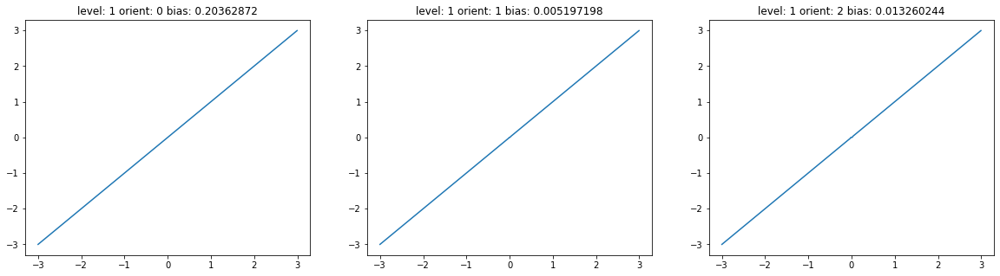

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


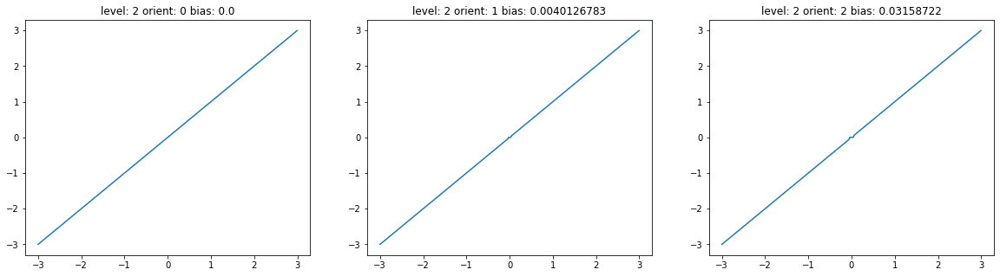

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


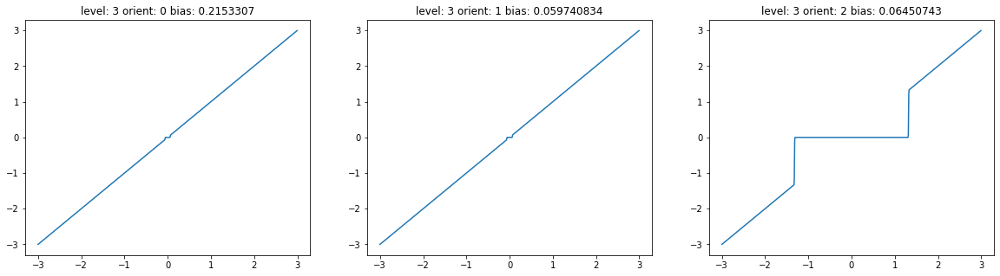

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


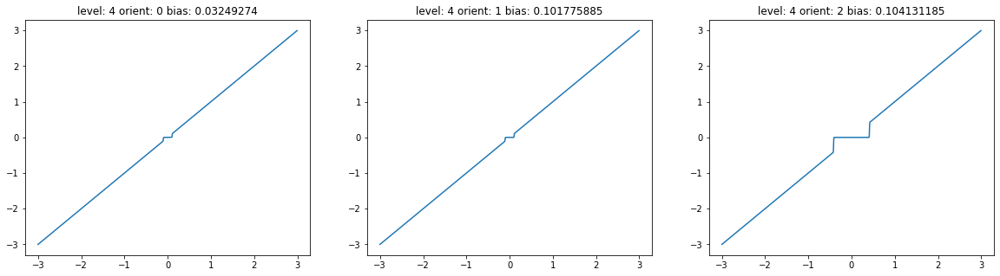

noise std:  0.09803921568627451


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


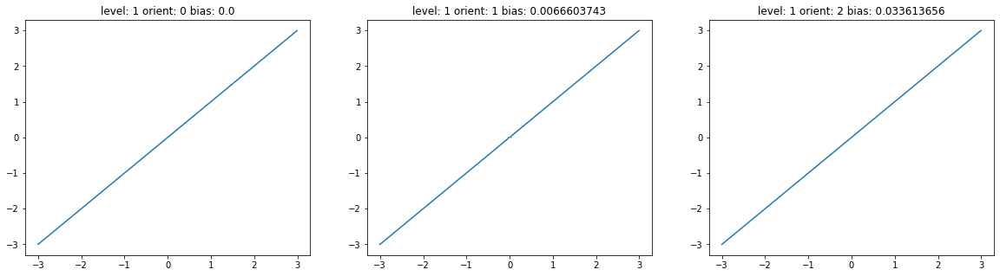

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


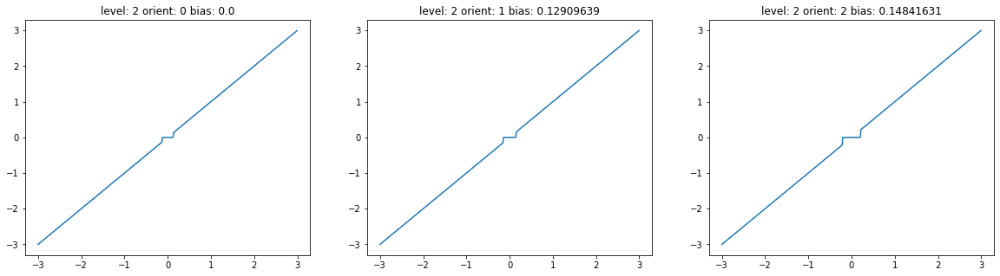

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


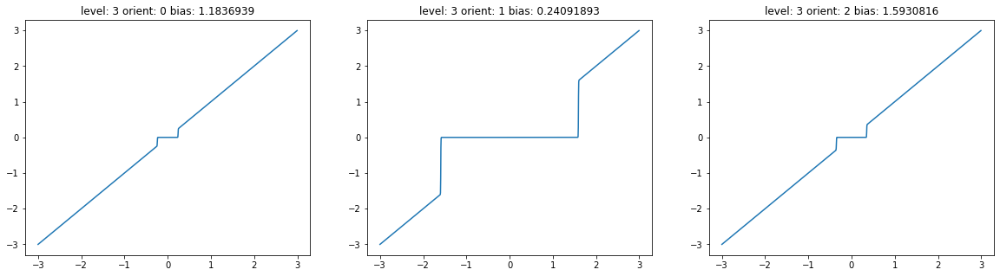

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


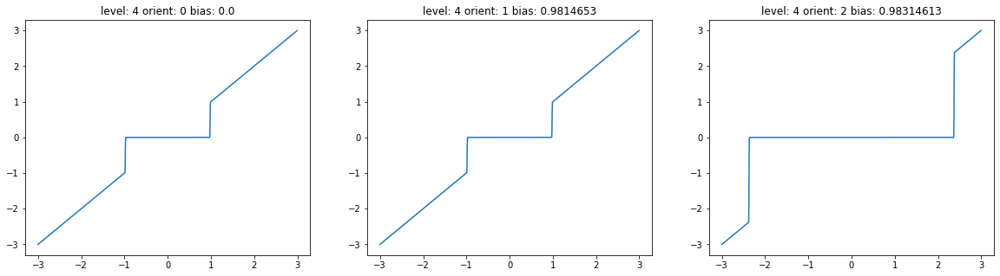

noise std:  0.21568627450980393


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


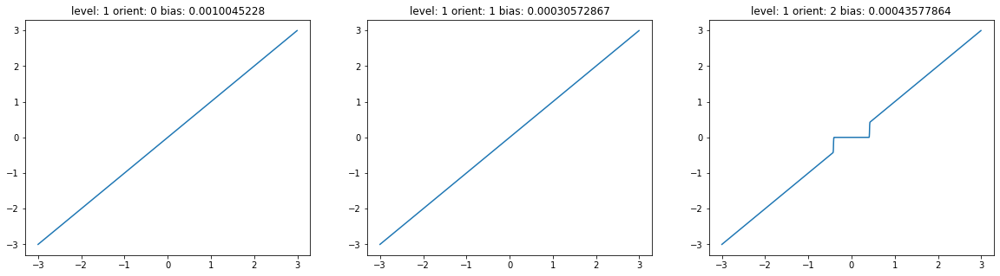

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


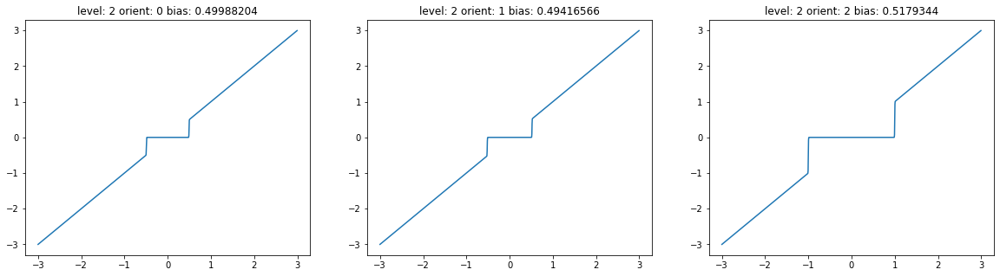

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


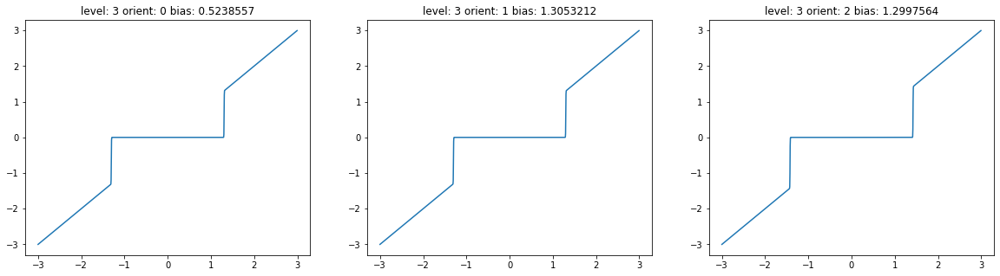

/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


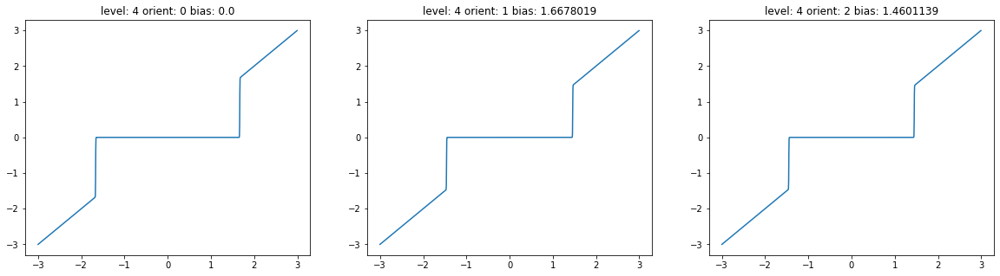

In [48]:
for noise_std in noise_std_array:
    print('noise std: ', noise_std)
    for kernel_size in kernel_size_list:
        plot_activation_functions(hard_net_dict[noise_std][kernel_size], max_val = 3)
    print('='*50)

# Block Thresholding With Haar Wavelets

In [49]:
import haar_block_threshold_2d_net
import copy

In [50]:
window_size = 5 

In [51]:
kernel_size_list = [2];
block_net_dict = {};

In [52]:
for noise_std in noise_std_array:
    print('='*50)
    print('noise std: ', noise_std);
    
    string_noise_std = str(int(noise_std*1000));
    
    net_dict_filename = 'block_haar_image_'+string_noise_std+'.pth';
    
    if os.path.exists(os.path.join(path_to_saved_models, net_dict_filename)): 
        print('Loaded from file..')
        net_dict = pickle.load( open( os.path.join(path_to_saved_models, net_dict_filename), "rb" ) )
#         kernel_size_list = list(net_dict.keys());
        block_net_dict[noise_std] = net_dict;
    else:
        net_dict = {}
        print('Training..')
        for kernel_size in kernel_size_list:
            net_temp = haar_block_threshold_2d_net.haar_block_threshold_2d(kernel_size=kernel_size, 
                                                        max_orient = 4, 
                                                        max_level = 4, 
                                                        window_size = window_size,
                                                        custom_wavelet = 'haar',
                                                        learn_transform_filters=False);
            
            net_temp = train_network_on_noise(net_temp, train_loader, val_loader, 
                                    add_noise = True, 
                                    noise_std = noise_std, 
                                    noise_mode = 'S', 
                                    max_epoch = 100, 
                                    milestone = 50, 
                                    lr = 1e-1, 
                                    verbose = True, 
                                    verbose_freq = 5, 
                                    plot_loss = True)
#             visualize_filters(net_temp)
            plt.show()
            print('='*50)
            net_dict[kernel_size] = net_temp;
            pickle.dump(net_dict, open( os.path.join(path_to_saved_models, net_dict_filename), "wb" ) )
        block_net_dict[noise_std] = net_dict;

noise std:  0.0392156862745098
Loaded from file..
noise std:  0.09803921568627451
Loaded from file..
noise std:  0.21568627450980393
Loaded from file..


### Val MSE and PNR for different kernel size

In [53]:
best_kernel_size = {};

for noise_std in noise_std_array:
    
    print('noise std: ', noise_std)
    best_kernel_psnr = 0;
    best_kernel = 0;
    for kernel_size in kernel_size_list:
        val_loss, val_psnr= validation_error_psnr(block_net_dict[noise_std][kernel_size], val_loader, 
                                                                add_noise = True, noise_std =  noise_std);
        print('Kernel Size: ', kernel_size, 'Val MSE: ', val_loss, 'Val PSNR: ', val_psnr)
#         visualize_filters(net_dict[kernel_size])
        plt.show()
        if val_psnr > best_kernel_psnr:
            best_kernel_psnr = val_psnr;
            best_kernel = kernel_size;
            
    best_kernel_size[noise_std] = best_kernel;
    print('='*50 + '\n\n')

noise std:  0.0392156862745098
Kernel Size:  2 Val MSE:  49.1733349609375 Val PSNR:  31.425535954975395


noise std:  0.09803921568627451


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


Kernel Size:  2 Val MSE:  169.842109375 Val PSNR:  26.4289675909401


noise std:  0.21568627450980393
Kernel Size:  2 Val MSE:  320.47431640625 Val PSNR:  23.6027696473408




### Visualizing Coefficient Utilities

In [54]:
def visualize_coeffs_tiled(coeffs, title_string, figsize):
    '''visulaizes wavelet coefficients in a tiled fashion. Assumes coeffs are from a complete representatoin
    i.e. there are only 3 bands per scale
    @coeffs: a list of tuples of arrays. Example for a wavelet pyramid of height 3: 
    [cA_n, (cH3_n, cV3_n, cD3_n), (cH2_n, cV2_n, cD2_n) , (cH1_n, cV1_n, cD1_n)]'''
    
    levels = len(coeffs) - 1
    
    image_size = 0
    for i in range(len(coeffs)): 
        image_size = coeffs[i][0].shape[0] + image_size
    
    temp = coeffs[0]
    for i in range(1, levels+1):
        temp1 = np.hstack((temp, coeffs[i][0]))
        temp2 = np.hstack((coeffs[i][1], coeffs[i][2]))
        temp = np.vstack((temp1, temp2))
        
    plt.figure(figsize= figsize)
    
    plt.imshow(temp, 'Purples')
    plt.xlim(-.5,image_size-.5)
    plt.ylim(image_size-.5,-.5)  
    plt.axis('off')

    # Add lines
    for i in range(levels): 
        plt.plot([image_size/(2)**(i+1)-.5, image_size/2**(i+1)-.5], [0-.5, image_size/ 2**(i) -.5], color='y', linestyle='-', linewidth=1)
        plt.plot([0, image_size/ 2**(i)-.5],[image_size/(2)**(i+1)-.5, image_size/2**(i+1)-.5], color='y', linestyle='-', linewidth=1)

    plt.savefig('plots/wav_' +title_string + '_wav.pdf',bbox_inches="tight")
    
    plt.show()

In [55]:
def visualize_coeffs(coeffs):
    levels = len(coeffs) - 1
    fig, axs = plt.subplots(levels, 3 ,figsize = (levels * 6, 15))
    axs = axs.ravel()
    
    for i,j in zip(range(0,levels*3,3) , range(1,levels+1)):
        axs[i].imshow(coeffs[j][0], 'gray')
        axs[i].set_title('Horizontal Coefficients \n level ' + str(j))
        axs[i+1].imshow(coeffs[j][1], 'gray')
        axs[i+1].set_title('Vertical Coefficients \n level ' + str(j))
        axs[i+2].imshow(coeffs[j][2], 'gray')
        axs[i+2].set_title('Diagonal Coefficients \n level ' + str(j))
        
    fig.tight_layout()

    plt.show()

## Compare Hard, Soft and Block Thresholding with Wiener

In [56]:
def rescale(img):
    if np.min(img) == np.max(img):
        return img;
    return (img - np.min(img) )/(np.max(img) - np.min(img))

def convert_to_pywt_standard(coeff_list):
    pywt_coeff_list = [None]*len(coeff_list);
    for i,x in enumerate(coeff_list):
        orient = x.shape[1];
        if orient == 1:
            pywt_coeff_list[i] = rescale( x.data.cpu().numpy()[0,0] );
        else:
            tuple_list = [None]* orient;
            for k in range(1, orient):
                tuple_list[k-1] = rescale( x[0, k].data.cpu().numpy() )
            pywt_coeff_list[i] = tuple(tuple_list)
    return pywt_coeff_list

In [57]:
def compare_wiener_and_wavelet(source, noise_std, wiener_star, net, net_block, net_hard, figsize = (30, 10), fft_sample = (180, 180),ind_fig=0):
    
    
    noisy = source + get_noise(source, noise_std=noise_std)
    wavelet_denoised = net(noisy.unsqueeze(0));
    wavelet_hard = net_hard(noisy.unsqueeze(0));
    wavelet_block = net_block(noisy.unsqueeze(0))
    
    source_coefficients = convert_to_pywt_standard( net.transform_net.forward_wavelet_transform(source.unsqueeze(0)) );
    noisy_coefficients = convert_to_pywt_standard( net.transform_net.forward_wavelet_transform(noisy.unsqueeze(0)));
    
    soft_coefficients = convert_to_pywt_standard( net.denoising_net(net.transform_net.forward_wavelet_transform( noisy.unsqueeze(0) ) ));
    hard_coefficients = convert_to_pywt_standard( net_hard.denoising_net(net_hard.transform_net.forward_wavelet_transform( noisy.unsqueeze(0) ) ));
    block_coefficients = convert_to_pywt_standard( net_block.denoising_net(net_block.transform_net.forward_wavelet_transform( noisy.unsqueeze(0) ) ));
    
    source_torch = source.clone().unsqueeze(0);
    source = source.numpy()[0]
    noisy = noisy.numpy()[0]
    
    
    source_fft = np.fft.fftshift( np.fft.fft2(source, s = fft_sample) );
    noisy_fft = np.fft.fftshift( np.fft.fft2(noisy, s = fft_sample) );
    denoised_fft = noisy_fft * wiener_star;
    
    source_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(source_fft), s= fft_sample) ), 0., 1. );
    noisy_ifft = np.clip( np.real(np.fft.ifft2( np.fft.ifftshift( noisy_fft), s = fft_sample)), 0., 1. );
    denoised_ifft = np.clip( np.real( np.fft.ifft2( np.fft.ifftshift(denoised_fft), s = fft_sample)), 0., 1. );
    
    fig, axes = plt.subplots(2, 6, sharex=True, sharey='row', figsize=figsize);
    axes[0, 0].imshow( source_ifft, cmap = 'gray' )
    axes[0, 0].axis('off')
    plot_2d_log_fft(source_ifft, axes[1, 0]);
    
    axes[0,1].imshow( noisy_ifft, cmap='gray' )
    axes[0,1].set_title('Noisy: '+str( compare_psnr(source_ifft, noisy_ifft, data_range=1.)) )
    axes[0,1].axis('off')
    plot_2d_log_fft(noisy_ifft, axes[1, 1]);
    
    
    axes[0,2].imshow(denoised_ifft, cmap = 'gray')
    axes[0,2].set_title('Wiener: '+str( compare_psnr(source_ifft, denoised_ifft, data_range=1.)) )
    axes[0,2].axis('off')
    plot_2d_log_fft(denoised_ifft, axes[1, 2]);
    
    axes[0, 3].imshow(tensor_to_image(wavelet_denoised), cmap='gray')
    axes[0, 3].axis('off')
    axes[0, 3].set_title('Soft: '+str(batch_PSNR(torch.clamp(wavelet_denoised, 0.0, 1.0), source_torch, 1.)))
    plot_2d_log_fft(tensor_to_image(wavelet_denoised), axes[1, 3]);
    
    axes[0, 4].imshow(tensor_to_image(wavelet_hard), cmap='gray')
    axes[0, 4].axis('off')
    axes[0, 4].set_title('Hard: '+str(batch_PSNR(torch.clamp(wavelet_hard, 0.0, 1.0), source_torch, 1.)))
    plot_2d_log_fft(tensor_to_image(wavelet_hard), axes[1, 4]);
    
    axes[0, 5].imshow(tensor_to_image(wavelet_block), cmap='gray')
    axes[0, 5].axis('off')
    axes[0, 5].set_title('Block: '+str(batch_PSNR(torch.clamp(wavelet_block, 0.0, 1.0), source_torch, 1.)))
    plot_2d_log_fft(tensor_to_image(wavelet_hard), axes[1, 5]);
    
#     plt.figure()
#     plt.imshow(source_ifft,cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_clean_'+str(ind_fig)+'.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(noisy_ifft,cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_noisy_'+str(ind_fig)+'.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(denoised_ifft,cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_wiener_'+str(ind_fig)+'.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(tensor_to_image(wavelet_hard),cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_thresh_'+str(ind_fig)+'.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(tensor_to_image(wavelet_block),cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_block_thresh_'+str(ind_fig)+'.pdf',bbox_inches="tight")
    
#     ind1_1 = 70
#     ind2_1 = 190
#     ind1_2 = 60
#     ind2_2 = 100
#     plt.figure()
#     plt.imshow(source_ifft[ind1_1:ind2_1,ind1_2:ind2_2],cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_clean_'+str(ind_fig)+'_zoom.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(noisy_ifft[ind1_1:ind2_1,ind1_2:ind2_2],cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_noisy_'+str(ind_fig)+'_zoom.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(denoised_ifft[ind1_1:ind2_1,ind1_2:ind2_2],cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_wiener_'+str(ind_fig)+'_zoom.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(tensor_to_image(wavelet_hard)[ind1_1:ind2_1,ind1_2:ind2_2],cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_thresh_'+str(ind_fig)+'_zoom.pdf',bbox_inches="tight")
    
#     plt.figure()
#     plt.imshow(tensor_to_image(wavelet_block)[ind1_1:ind2_1,ind1_2:ind2_2],cmap='gray')
#     plt.xticks([])
#     plt.yticks([])
#     plt.savefig('plots/wav_block_thresh_'+str(ind_fig)+'_zoom.pdf',bbox_inches="tight")
     
#     plt.subplots_adjust(wspace=0, hspace=0)
    
#     plt.show()
    
#     print('Wavelet Coefficient Plots...')
    
#     coeff_figsize = (20, 20)
#     visualize_coeffs_tiled(source_coefficients, title_string='clean_' + str(ind_fig), figsize = coeff_figsize)
#     visualize_coeffs_tiled(noisy_coefficients, title_string='noisy_' + str(ind_fig), figsize = coeff_figsize)
#     visualize_coeffs_tiled(soft_coefficients, title_string='soft_' + str(ind_fig), figsize = coeff_figsize)
#     visualize_coeffs_tiled(hard_coefficients, title_string='thresh_' + str(ind_fig), figsize = coeff_figsize)
#     visualize_coeffs_tiled(block_coefficients, title_string='block_thresh_' + str(ind_fig), figsize = coeff_figsize)

In [58]:
image_number_list = [227]

In [59]:
special_image_list = [os.path.join(path_to_image_data, 'test_'+str(x)+'.png') for x in image_number_list]

In [60]:
special_image_dataset = image_dataset.Dataset(special_image_list, resize_to_256=True)



Noise Std:  0.0392156862745098


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:35: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:41: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


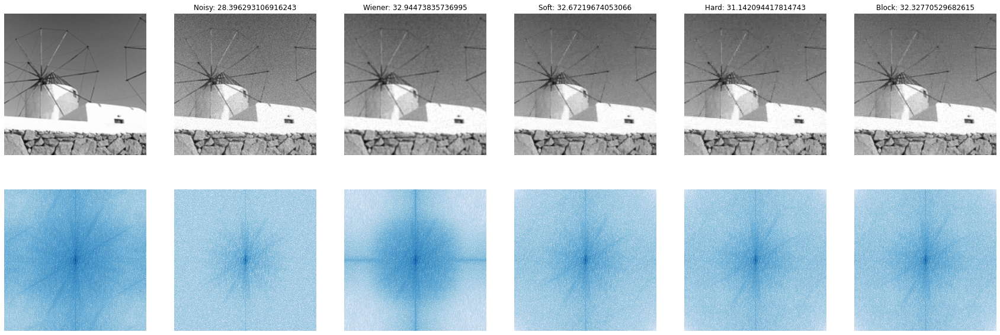



Noise Std:  0.09803921568627451


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until


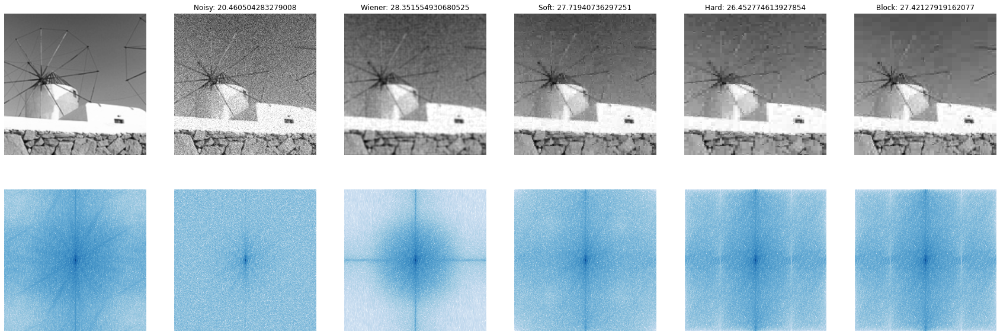



Noise Std:  0.21568627450980393


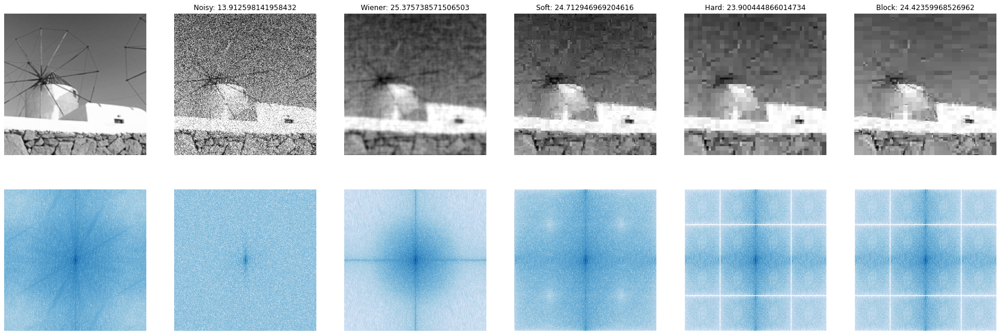

In [61]:
for ind,noise_std in enumerate(noise_std_array):
    print('='*50 +'\n\n')
    print('Noise Std: ', noise_std) 
    for i in range(len(special_image_dataset)):
        compare_wiener_and_wavelet(special_image_dataset[i], noise_std, wiener_star[noise_std],
                                       super_net_dict[noise_std][best_kernel_size[noise_std]], 
                                       block_net_dict[noise_std][best_kernel_size[noise_std]],
                                       hard_net_dict[noise_std][best_kernel_size[noise_std]], fft_sample = (256, 256),ind_fig = ind)
        plt.show()

### Comparing on Validation Images



Noise Std:  0.0392156862745098


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:35: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:41: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  


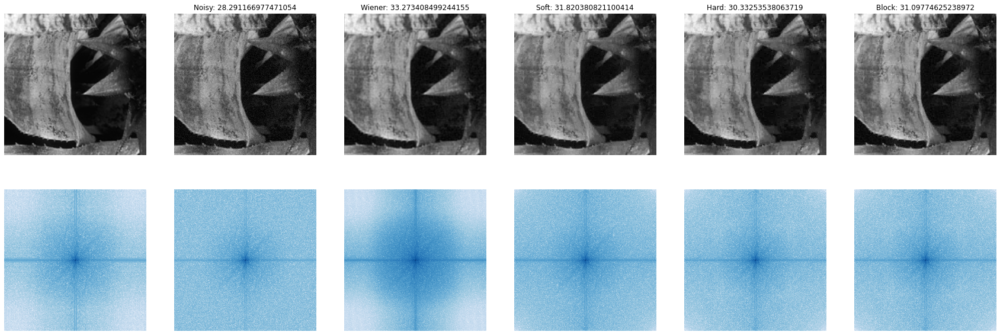

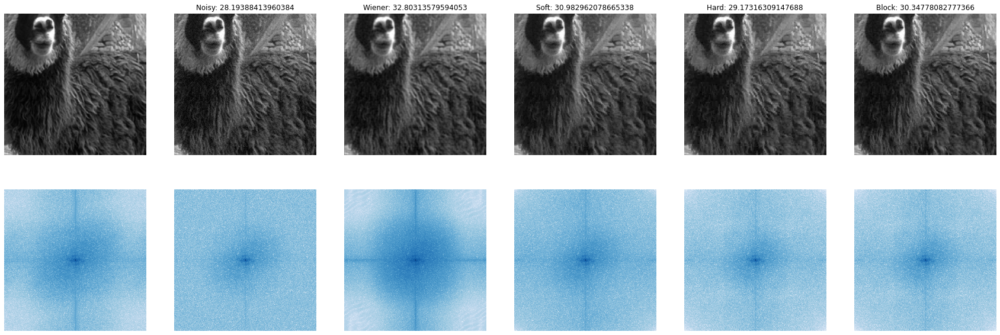

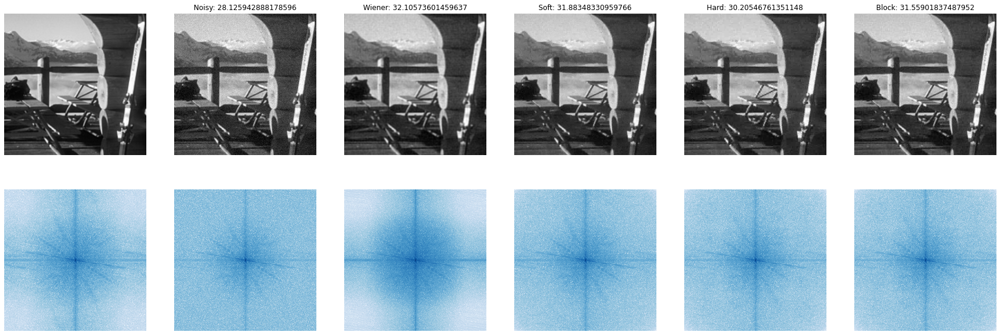



Noise Std:  0.09803921568627451


/Users/sreyas/miniconda3/envs/denoising/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until


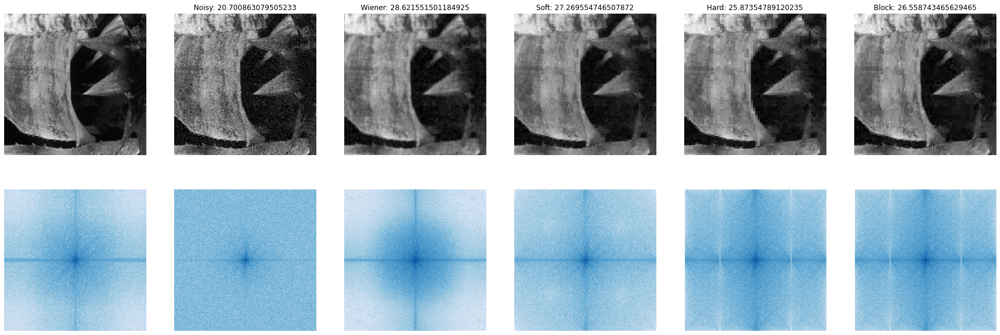

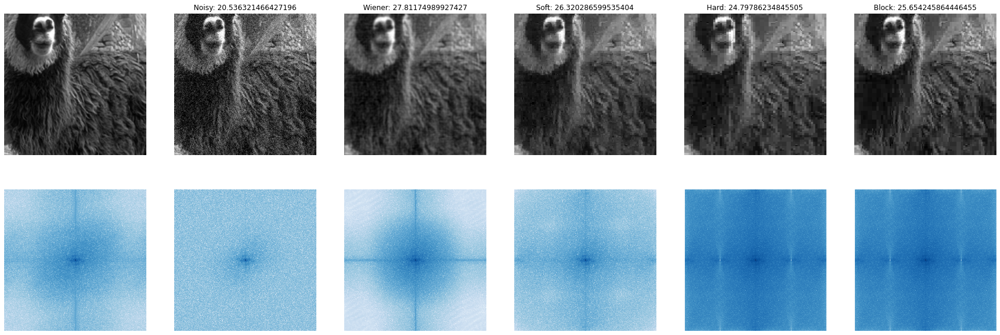

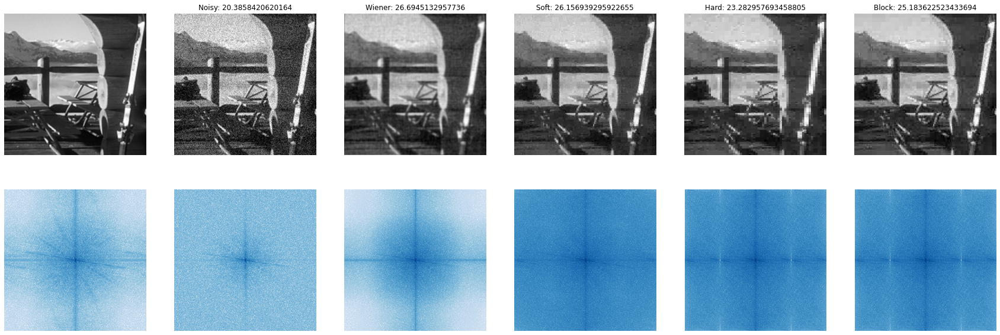



Noise Std:  0.21568627450980393


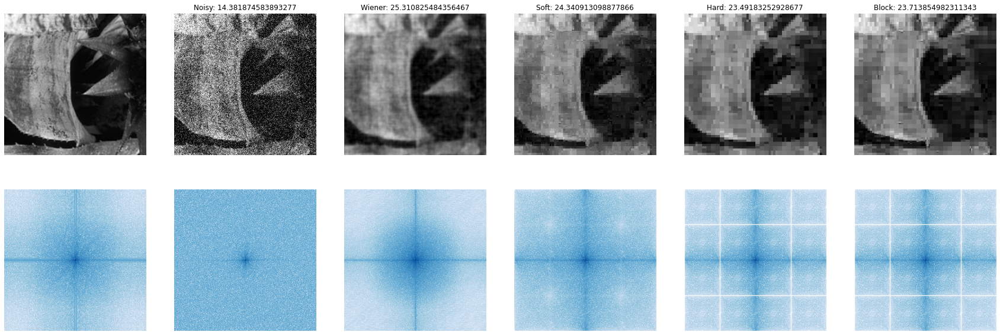

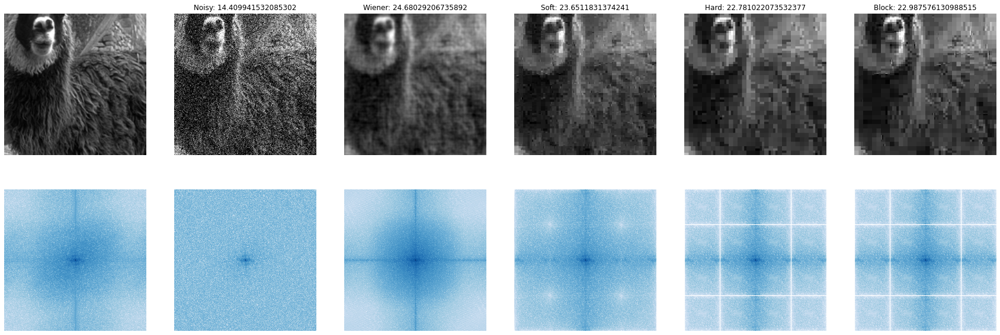

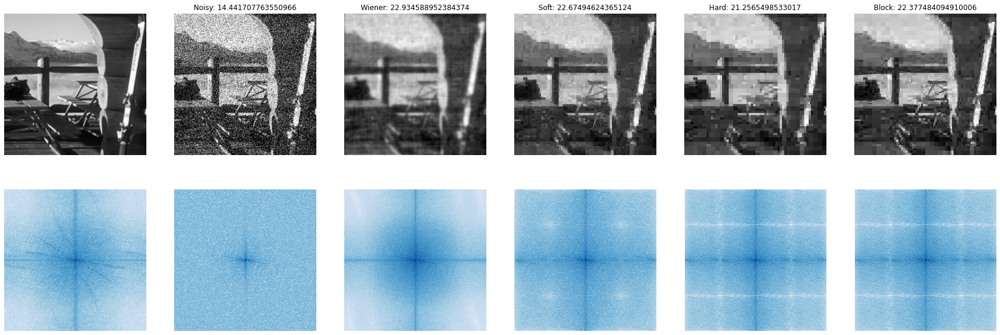

In [62]:
for noise_std in noise_std_array:
    print('='*50 +'\n\n')
    print('Noise Std: ', noise_std) 
    for i in range(3):
        compare_wiener_and_wavelet(val_dataset[i], noise_std, wiener_star[noise_std],
                                       super_net_dict[noise_std][best_kernel_size[noise_std]], 
                                       block_net_dict[noise_std][best_kernel_size[noise_std]], 
                                       hard_net_dict[noise_std][best_kernel_size[noise_std]], fft_sample = (256, 256))
    plt.show()